# LSI31003 Machine Learning in Molecular Biology Assignment 2

## Heidi Putkuri - 014976544
In this notebook I have used both GPT-4 and github copilot plugin from VSCODE to generate some of the codes. 

In [1]:
from setup import *
import re
import seaborn as sns
from scipy.stats import *
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import mean_squared_error


In [2]:
#need to install some modules first so execute this cell
# Install a pip package in the current Jupyter kernel
import sys
!{sys.executable} -m pip install scikit-learn

In [3]:
## ploting 96 mutational channels
col_set = ['#0343df','#000000','#e50000','#929591','#3f9b0b','#ff81c0']
col_list = []
for i in range (len(col_set)):
    col_list += [col_set[i]] * 16

def plot_mutationchannels(sig, name=""):
    sns.set(rc={"figure.figsize":(11,2.5)})
    sns.set(style="whitegrid", color_codes=True)

    plt.bar(sig.index, sig, width = 0.5, color = col_list)
    plt.xticks(rotation=90, size = 7, weight='bold')
    plt.title (name, size = 12, weight='bold')
    plt.tight_layout()
    plt.show()
    

## Problem 1: Inference from simulated data <a id='Problem1'></a>

We will continue on the mutational signatures theme but now the task is to do a *de novo* inference of signatures from a given mutation count matrix. In problem 1, we will perform this on simulated data for which we already known the correct answer. Before doing it, we need to first load the signatures and simulate samples using the signatures.

In [4]:
SBS_sig = pd.read_csv("./data/MutSigCancer/SBS_signatures.csv")
SBS_sig = SBS_sig.set_index (SBS_sig['Type'] + "_" + SBS_sig['SubType'])
SBS_sig.head(2)

,Type,SubType,SBS1,SBS2,SBS3,SBS4,SBS5,SBS6,SBS7a,SBS7b,...,SBS51,SBS52,SBS53,SBS54,SBS55,SBS56,SBS57,SBS58,SBS59,SBS60
C>A_ACA,C>A,ACA,0.000886,5.800000e-07,0.0208,0.0422,0.01200,0.000425,0.000067,0.002330,...,0.14100,0.01520,0.00538,0.002160,0.00588,0.0126,0.01230,0.05890,0.00359,0.006150
C>A_ACC,C>A,ACC,0.002280,1.480000e-04,0.0165,0.0333,0.00944,0.000524,0.000179,0.000461,...,0.00169,0.00654,0.00196,0.000796,0.00205,0.0157,0.00143,0.00675,0.00237,0.000779


### Problem 1a: 
Generate simulated data sets using a subset (varying the number between 4-10) of the signatures given above using the simulate_Poisson_channels function below.

The function below shows an example of simulating process for one synthetic sample.

In [5]:

# import poisson from scipy.stats
from scipy.stats import poisson
def simulate_Poisson_channels(mean_number_active_signatures, mean_number_of_mutations, signatures):
    """ 
    Simulate a Poisson process with a given mean number of
    active signatures, mean number of mutations and a set of signatures
    
    Input:
    mean_number_active_signatures: mean number of active signatures
    mean_number_of_mutations: mean number of mutations
    signatures: a set of signatures
    
    Output:
    sim: a simulated mutational catalog
    
    """
    N_active_signatures = 1 + poisson.rvs(mean_number_active_signatures-1,
                                            loc=0, # loc is the mean of the distribution, here 0
                                            size=1,
                                            random_state=None)
    N_signatures = signatures.shape[0]
    
    if N_active_signatures[0] > N_signatures:
        N_active_signatures[0] = N_signatures
    active_signatures = np.random.choice(N_signatures, N_active_signatures, replace=False)
    activities = dirichlet.rvs(np.zeros(N_active_signatures)+0.5, size=1)
    activities = activities[0]
    activities_X = np.zeros(N_signatures)
    for n in range(N_active_signatures[0]):
        activities_X[active_signatures[n]] = activities[n]
        
    channel_intensities = np.matmul(activities_X, signatures)
    channel_intensities = mean_number_of_mutations*channel_intensities
    
    sim = poisson.rvs(channel_intensities)
    
    return sim

For simplicity, here we only use the the top five signatures in our simulation. You can select a few signatures what you are interested in your own simulation.

In [6]:
top_five_signatures = SBS_sig.iloc[:,2:7].to_numpy().T
top_five_signatures.shape

(5, 96)

In [7]:
dataset=np.zeros((100,96))
for i in range(100):
    dataset[i]=simulate_Poisson_channels(3,1000,top_five_signatures)


In [8]:
dataset.shape

(100, 96)

# Answer 1a

In [9]:
# geenerate a simulated datasets with varying number of mutations
datasets = {}
# ranging from 4 to 7 active signatures
for i in range(1,6):
    sliced_sig = SBS_sig.iloc[:,2:i+2].to_numpy().T
    datasets[i] = np.zeros((100,96))
    for j in range(100):
        datasets[i][j] = simulate_Poisson_channels(3,1000,sliced_sig)
    

In [10]:
datasets[1].shape

(100, 96)

In [11]:
signatures_heidi = SBS_sig.iloc[:,7:11].to_numpy().T # we choose how many signatures we want to use--> 
simulated_dataset_heidi=np.zeros((100,96)) # we choose how many samples we want to simulate
for i in range(100): # generate 100 samples
    simulated_dataset_heidi[i]=simulate_Poisson_channels(3,1000,signatures_heidi) # we choose the number of active signatures and the number of mutations

In [12]:
simulated_dataset_heidi

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 2.,  1.,  0., ...,  7.,  4., 12.],
       [ 0.,  0.,  0., ...,  0.,  0.,  1.],
       ...,
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 2.,  0.,  0., ...,  8.,  8.,  9.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.]])

### Problem 1b: 
Try to infer the signatures back from the simulated data. The first step is to decide how many signatures are active in the input dataset. To do this model selection task, we recommend to read the well-known WTSI framework described in Alexandrov *et al.*'s earlier paper ["Alexandrov LB, et al. (2013) Deciphering Signatures of Mutational Processes Operative in Human Cancer. Cell Reports 2013](https://www.sciencedirect.com/science/article/pii/S2211124712004330) and the newer version ["Alexandrov LB, et al. (2020) The repertoire of mutational signatures in human cancer. Nature"](https://www.nature.com/articles/s41586-020-1943-3). Fixing the number of active signatures, we can use non-negative matrix factorization to decomposite the input matrix to a basic component matrix (signature matrix) and a <br> weight matrix (the activities of the signatures).

Please note the problem of over fitting, i.e., using too many signatures will likely pose a problem.

We show here as an example that using the correct signature number (five here) gives back a good inference.

In [13]:
# need to import NMF solver
from sklearn.decomposition import NMF
model = NMF(n_components=5, init='random', random_state=0) # this is the NMF model which models the data
W = model.fit_transform(dataset.T)
H = model.components_ 

# weights (or activities)
H.shape
# basic component(or mutational signatures) 
W.shape

(96, 5)

In [14]:
print(H.shape, W.shape)

(5, 100) (96, 5)


Let's compare the solutions from NMF to the real signatures used in our simulation

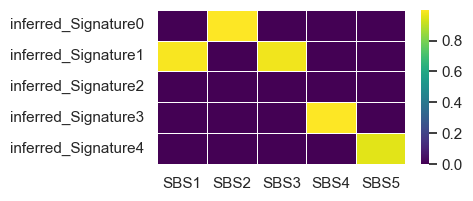

In [15]:
comp = np.amax(cosine_similarity(top_five_signatures, W.T), 1)
sim = cosine_similarity(top_five_signatures, W.T)
sim[sim < 0.9] = 0

sns.set(rc={"figure.figsize":(4,2)})
sns.heatmap(sim, linewidth = 0.5, cmap = 'viridis', xticklabels = SBS_sig.columns[2:7].values, 
                 yticklabels =  ["inferred_Signature" + str(i) for i in range(5)])
plt.show()

The cosine similarities between the predicted signatures and the input are very close. So the model works really well in this case when we give 5 as the total signature number. In real case, we do not know this number, so the model selection step is critically important here. Please write your solutions how to do the model selection. i.e., take signature numbers from 2 to 10 and use various metrics to decide which one is the best signature number for your input data without using the correct solution that we know in any way.

# Answer 1b

### First we use elbow method to find the best signature number
This means that we just calculate the reconstruction error for different signature numbers and choose the one that gives the best reconstruction error.



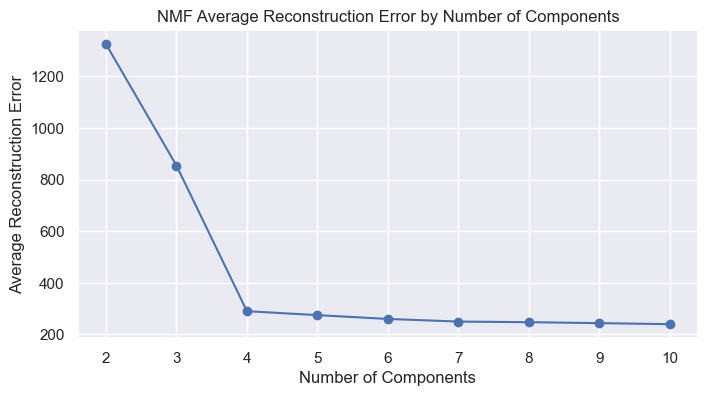

In [16]:
from joblib import Parallel, delayed
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.decomposition import NMF


def fit_nmf(n_components, simulation_index, dataset):
    """ 
    Fit NMF model with a given number of components and dataset
    
    Input:
    n_components: number of components
    simulation_index: simulation index
    dataset: dataset for NMF
    """
    model = NMF(n_components=n_components, init='nndsvda',
                solver='mu', max_iter=1000, tol=1e-3, random_state=simulation_index)
                # here the number of iterations is set to 1000 and the tolerance to 1e-3
                # the tolerance means that the algorithm will stop if the difference between 
                # the previous and the current reconstruction error is less than 1e-3 this is done to speed up the algorithm
                # solver is set to 'mu' which means multiplicative update algorithm is used, 
                # which means that the algorithm will use the multiplicative update rules to update the W and H matrices. 
                # init is set to 'nndsvda' which means that the algorithm will use the NNDSVD algorithm 
                # to initialize the W and H matrices. NNDSVD means Nonnegative Double Singular Value Decomposition
    
    model.fit_transform(dataset.T)
    return model.reconstruction_err_

# Parameters for the simulations
n_components_range = range(2, 11)  # Exploring number of components from 2 to 10
n_simulations = 100  # Number of simulations per number of components

# Using Parallel to run NMF fitting in parallel across simulations for each number of components
results = Parallel(n_jobs=-1)(
    delayed(fit_nmf)(n_components, simulation, simulated_dataset_heidi)
    for n_components in n_components_range
    for simulation in range(n_simulations)
)

results_matrix = np.array(results).reshape(len(n_components_range), n_simulations)

average_reconstruction_error = np.mean(results_matrix, axis=1)

# Plotting
sns.set(rc={"figure.figsize":(8, 4)})  # Set figure size
plt.plot(n_components_range, average_reconstruction_error, marker='o')  # Plot with markers
plt.xlabel("Number of Components")
plt.ylabel("Average Reconstruction Error")
plt.title("NMF Average Reconstruction Error by Number of Components")
plt.xticks(n_components_range)  
plt.grid(True)  
plt.show()

In [17]:
# lets write a function which 

In the plot we can see that after 4 components the average reconstruction error is not decreasing as much as before. So we can use 4 as the best number of components.

In [18]:

error_library = {}
similarity_library = {}

for i in range(2,11): # number of components
    reconstruction_error = []
    similarity = []
    for j in range(5): # number of simulations to do 
        model = NMF(n_components=i)
        # save W to list 
        W = model.fit_transform(simulated_dataset_heidi.T)


        H = model.components_
        reconstruction_error.append(model.reconstruction_err_)
        similarity.append(cosine_similarity(signatures_heidi, W.T))

    similarity_library[i] = similarity

    error_library[i] = reconstruction_error


In [19]:
result_library = {}
for item, value in error_library.items():
    # save mean and variance of the reconstruction error to a dictionary
    result_library[item] = [np.mean(value), np.var(value)]


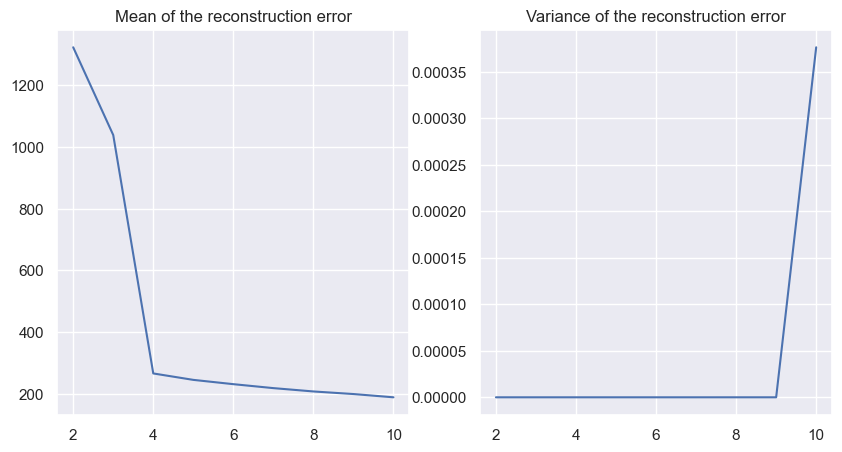

In [20]:
sns.set(rc={"figure.figsize":(10,5)})
plt.subplot(1,2,1)
plt.title("Mean of the reconstruction error")
plt.plot(list(result_library.keys()), [item[0] for item in result_library.values()])
plt.subplot(1,2,2)
plt.title("Variance of the reconstruction error")
plt.plot(list(result_library.keys()), [item[1] for item in result_library.values()])
plt.show()


Altough the reconstruction error decreases as we add more components, the difference is not significant after 4 components. And also we can see in the variance of the reconstruction error that after 4 components the variance is 0 but when we reach 9 it starts to increase drastically. So we can use 4 as the best number of components.

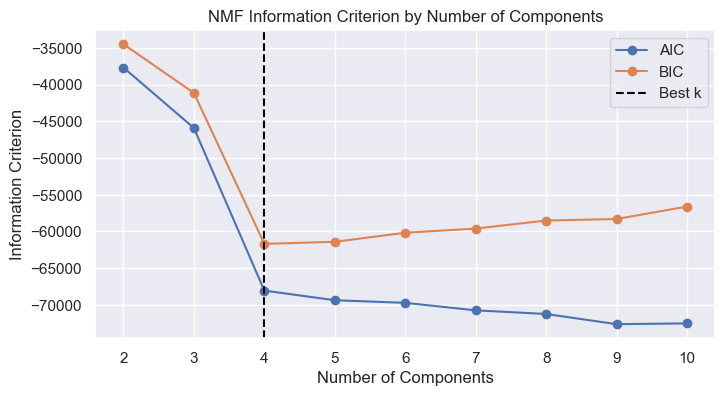

In [21]:
# using AIC and BIC or residual error to find the best number of components
def calculate_aic_bic(V, W, H, k):
    # Calculate the reconstruction error
    reconstruction_error = mean_squared_error(V, np.dot(W, H))
    
    # fix the number of parameters to be the same as in the NMF model
    n_params = k * (V.shape[0] + V.shape[1] - 1)
    
    # Calculate AIC and BIC, using reconstruction error as a proxy for -2ln(L)
    aic = n_params + V.size * np.log(reconstruction_error / V.size)
    bic = np.log(V.size) * n_params + V.size * np.log(reconstruction_error / V.size)
    
    return aic, bic

V = simulated_dataset_heidi
k_values = range(2, 11) # Range of k values to test
results = []

# trying the different number of components
for k in k_values:
    model = NMF(n_components=k,)
    W = model.fit_transform(V)
    H = model.components_
    aic, bic = calculate_aic_bic(V, W, H, k)
    results.append((k, aic, bic))

# Select the k with the lowest BIC (or AIC)
best_k = min(results, key=lambda x: x[2])[0]

# Plotting AIC and BIC and the best number of components
sns.set(rc={"figure.figsize":(8, 4)})
plt.plot(k_values, [item[1] for item in results], marker='o', label='AIC')  
plt.plot(k_values, [item[2] for item in results], marker='o', label='BIC') 
plt.axvline(best_k, color='black', linestyle='--', label='Best k')
plt.xlabel("Number of Components")
plt.ylabel("Information Criterion")
plt.title("NMF Information Criterion by Number of Components")
plt.xticks(k_values)
plt.legend()
plt.grid(True)
plt.show()






In [22]:
# function to get the number of components for each simulation

def calculate_aic_bic(V, W, H, k):
    """Calculate AIC and BIC, using the mean squared reconstruction error as a proxy for the likelihood."""
    mse = mean_squared_error(V, np.dot(W, H))
    # Calculate the number of elements in V
    n_elements = np.prod(V.shape)
    # Number of parameters: for each component k, we have (n_features + n_samples) parameters
    n_params = k * (V.shape[0] + V.shape[1])
    # Calculate AIC and BIC
    aic = n_params + n_elements * np.log(mse)
    bic = np.log(n_elements) * n_params + n_elements * np.log(mse)
    return aic, bic

def find_best_n_components(V, max_k=10, tol=0.05):
    """Find the best number of components for NMF using BIC with a tolerance level."""
    results = []
    for k in range(1, max_k+1):
        model = NMF(n_components=k)
        W = model.fit_transform(V)
        H = model.components_
        aic, bic = calculate_aic_bic(V, W, H, k)
        results.append((k, aic, bic))
    
    # Find the minimum BIC value and the corresponding k
    min_bic_result = min(results, key=lambda x: x[2])
    min_bic = min_bic_result[2]
    best_k = min_bic_result[0]
    max_allowable_k = min(V.shape) - 1  # n_components must be <= min(n_samples, n_features) for 'nndsvd'
    max_k = min(max_k, max_allowable_k)
    
    # Check if there's a k within the specified tolerance of the minimum BIC
    for result in results:
        if result[2] <= (1 + tol) * min_bic:
            best_k_within_tol = result[0]
            # If multiple k values meet the tolerance condition, choose the smallest k
            best_k = best_k_within_tol if best_k_within_tol < best_k else best_k
            break  # Stop checking after finding the first k within tolerance

    return best_k

In [23]:
V = simulated_dataset_heidi
best_k = find_best_n_components(V)
print(f"The best number of components is: {best_k}")

The best number of components is: 4


### AIC
Aic is a method to find the best model. The model with the lowest AIC is the best model. The formula is AIC = 2k - 2ln(L), where k is the number of parameters and L is the likelihood function. The lower the AIC, the better the model.

### BIC
BIC is a method to find the best model. The model with the lowest BIC is the best model. The formula is BIC = kln(n) - 2ln(L), where k is the number of parameters, n is the number of samples and L is the likelihood function. The lower the BIC, the better the model.

### Problem 2: Inference with real data <a id='Problem1'></a>

#### Problem 2a: 
Use the data set from ["Alexandrov LB, et al. (2020) The repertoire of mutational signatures in human cancer. Nature"](https://www.nature.com/articles/s41586-020-1943-3) and perform signature extraction. Do this for one cancer type at a time. Map the resulting signatures onto the given signatures. How many of them you can find if you call a match if cosine similarity is bigger than 0.9? 

Here is an example but again no inference on what would be a good number of signatures is done. 

In [24]:
somaticMutations = pd.read_csv ("./data/MutSigCancer/WGS_PCAWG.96.csv")
somaticMutations = somaticMutations.set_index (somaticMutations['Mutation type'] + "_" + somaticMutations['Trinucleotide'])

In [25]:
## the cancer types in our dataset
set([re.search(r'(\S+)\:\:\w+', sample_id).groups()[0] for sample_id in list(somaticMutations.columns[2:])])

{'Biliary-AdenoCA',
 'Bladder-TCC',
 'Bone-Benign',
 'Bone-Epith',
 'Bone-Osteosarc',
 'Breast-AdenoCA',
 'Breast-DCIS',
 'Breast-LobularCA',
 'CNS-GBM',
 'CNS-Medullo',
 'CNS-Oligo',
 'CNS-PiloAstro',
 'Cervix-AdenoCA',
 'Cervix-SCC',
 'ColoRect-AdenoCA',
 'Eso-AdenoCA',
 'Head-SCC',
 'Kidney-ChRCC',
 'Kidney-RCC',
 'Liver-HCC',
 'Lung-AdenoCA',
 'Lung-SCC',
 'Lymph-BNHL',
 'Lymph-CLL',
 'Myeloid-AML',
 'Myeloid-MDS',
 'Myeloid-MPN',
 'Ovary-AdenoCA',
 'Panc-AdenoCA',
 'Panc-Endocrine',
 'Prost-AdenoCA',
 'Skin-Melanoma',
 'SoftTissue-Leiomyo',
 'SoftTissue-Liposarc',
 'Stomach-AdenoCA',
 'Thy-AdenoCA',
 'Uterus-AdenoCA'}

we briefly show how to use NMF identify signatures in real samples. Take breast cancer as an example:

In [26]:
## extract the input matrix for breast cancers.
target_index = [re.search(r'(\S+)\:\:\w+', sample_id).groups()[0] == "Breast-AdenoCA"  for sample_id in list(somaticMutations.columns[2:])]
target_mutations = somaticMutations.iloc[:,2:].loc[:, target_index]
target_mutations.head(3)

,Breast-AdenoCA::SP117956,Breast-AdenoCA::SP117975,Breast-AdenoCA::SP2149,Breast-AdenoCA::SP117113,Breast-AdenoCA::SP117245,Breast-AdenoCA::SP117402,Breast-AdenoCA::SP117136,Breast-AdenoCA::SP117378,Breast-AdenoCA::SP116947,Breast-AdenoCA::SP117369,...,Breast-AdenoCA::SP2731,Breast-AdenoCA::SP6223,Breast-AdenoCA::SP7171,Breast-AdenoCA::SP10563,Breast-AdenoCA::SP8987,Breast-AdenoCA::SP5980,Breast-AdenoCA::SP12186,Breast-AdenoCA::SP10944,Breast-AdenoCA::SP2766,Breast-AdenoCA::SP6673
C>A_ACA,35,36,217,50,35,43,30,22,52,92,...,47,198,71,56,188,193,70,144,162,316
C>A_ACC,29,36,181,20,32,43,27,9,44,48,...,30,158,44,33,169,160,54,111,116,393
C>A_ACG,5,2,36,5,3,7,9,6,8,9,...,7,24,8,3,21,24,9,19,25,48


In [27]:
## we have 198 samples here
target_mutations.shape

(96, 198)

Next we run NMF on breast cancer data by using the an arbitrary signature number 5 in the model. Please note, you need to learn the number of signatures for each cancer type, using the method that came up in problem 1.

In [28]:
input_data = target_mutations.values
model = NMF(n_components=5, init='random', random_state=0)
W = model.fit_transform(input_data)
H = model.components_



Plot the inferred signatures, note they are not automatically normalised to probability densities which is done in the code below

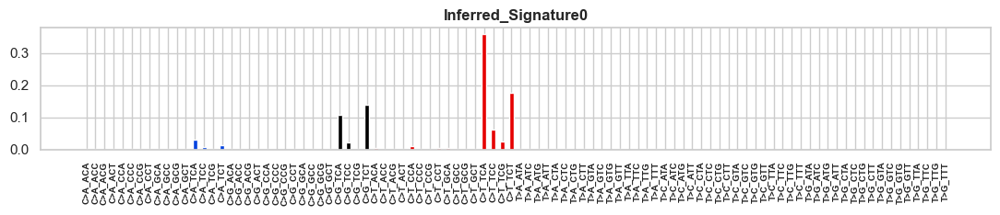

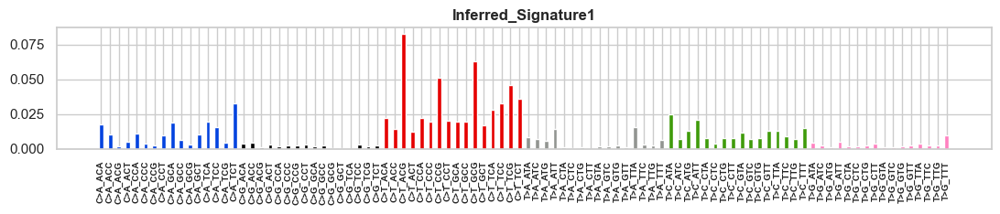

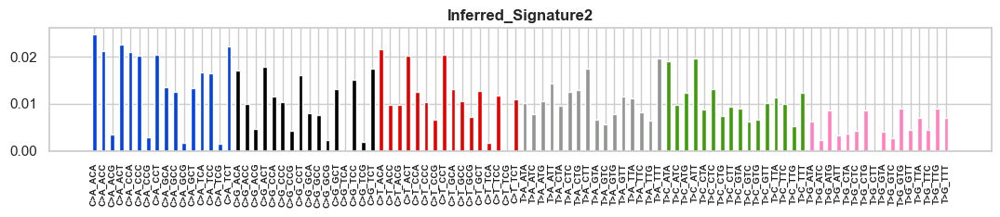

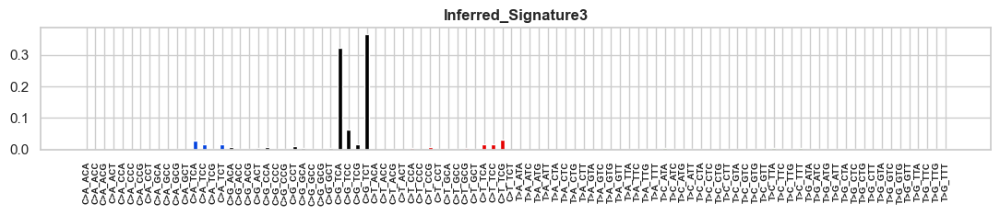

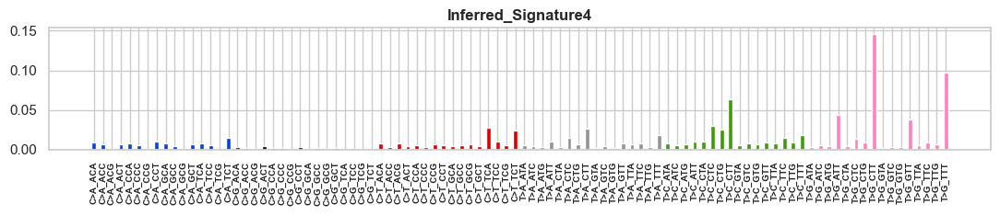

In [29]:
for i in range(5):
    s = pd.Series ( W.T[i]/sum(W.T[i]), index = list(target_mutations.index.values))
    name = "Inferred_Signature" + str(i)
    plot_mutationchannels(s, name)

Compare the learned signatures to the known signatures

In [30]:
sim = cosine_similarity(W.T, SBS_sig.iloc[:,2:].values.T)
## only consider those with consine similarity are above 0.9
sim[sim < 0.9] = 0

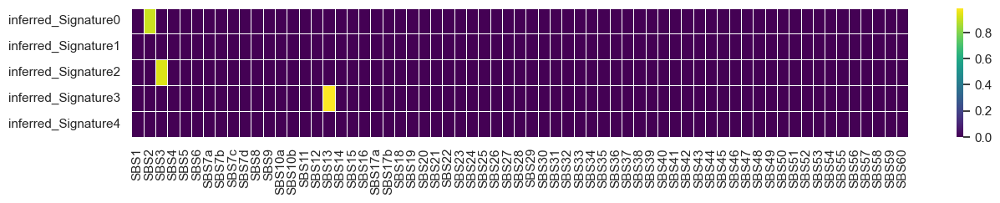

In [31]:
sns.set(rc={"figure.figsize":(15,2)})
sns.heatmap(sim, linewidth = 0.5, cmap = 'viridis', xticklabels = SBS_sig.columns[2:].values, 
                 yticklabels =  ["inferred_Signature" + str(i) for i in range(5)])
plt.show()

so we found three good matches to the known SBS2,SBS3 and SBS13, with cosine similarity > 0.90. Do the inference on other cancer types and perform model selection on each of them.

In [32]:
# how many cancer types do we have in our dataset
cancer_types=set([re.search(r'(\S+)\:\:\w+', sample_id).groups()[0] for sample_id in list(somaticMutations.columns[2:])])
len(cancer_types)

37

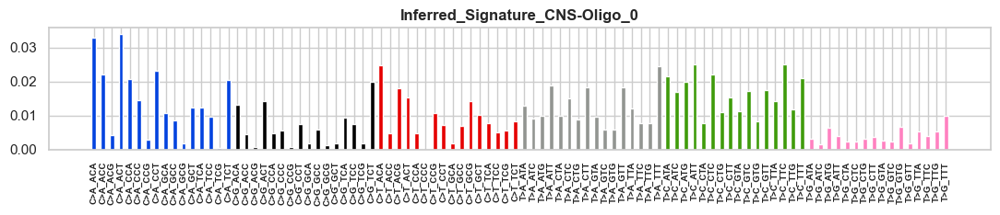

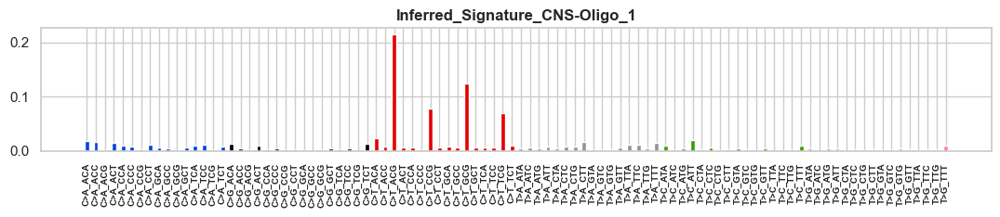

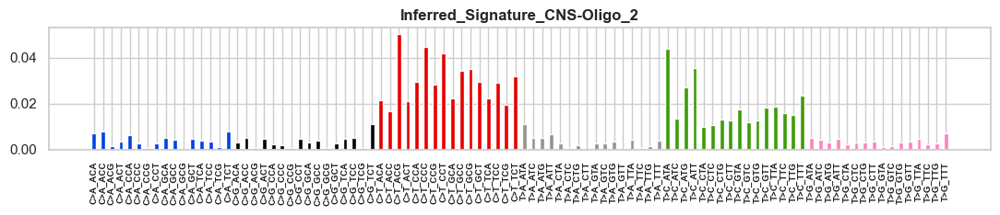

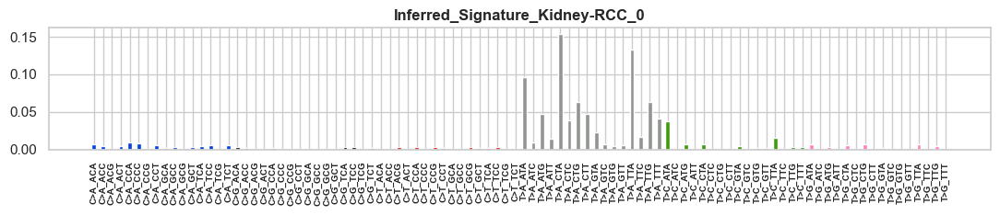

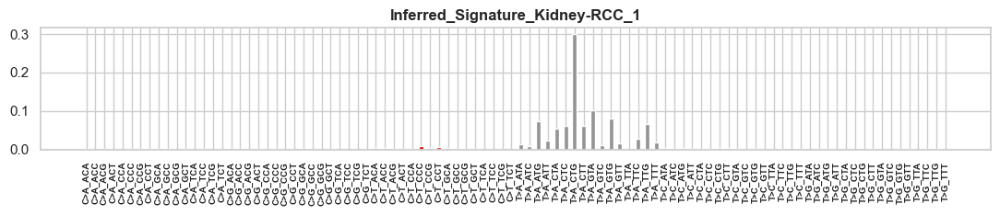

...

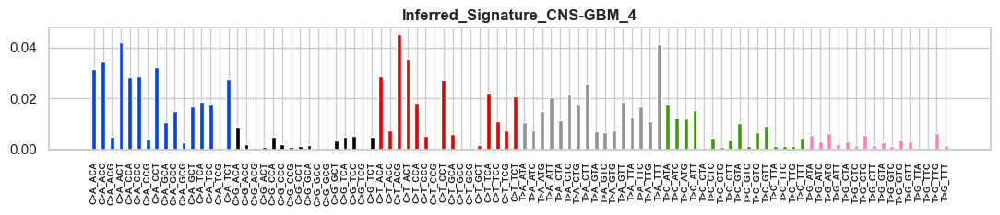

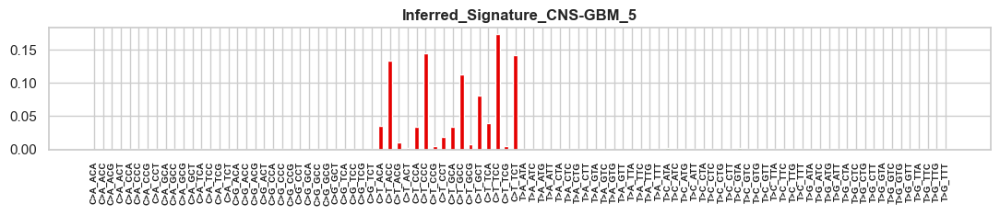

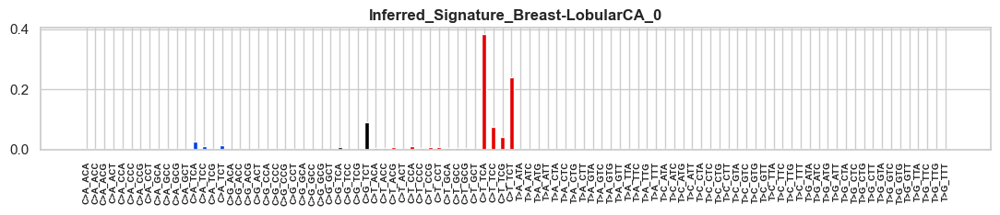

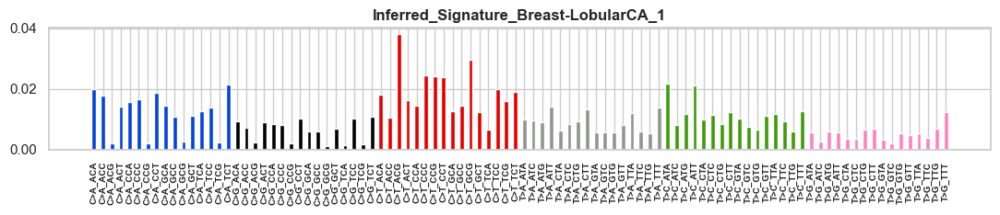

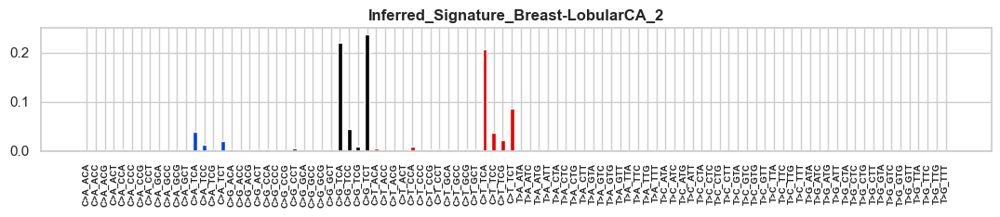

In [33]:
cancer_types=set([re.search(r'(\S+)\:\:\w+', sample_id).groups()[0] for sample_id in list(somaticMutations.columns[2:])])

signature_comparison_results = {}
best_k_for_cancer_type = {}
for cancer_type in cancer_types:

    # here first we extract the input matrix for each cancer type
    target_index = [re.search(r'(\S+)\:\:\w+', sample_id).groups()[0] == cancer_type  for sample_id in list(somaticMutations.columns[2:])]
    target_mutations = somaticMutations.iloc[:,2:].loc[:, target_index]

    # define the input data
    input_data = target_mutations.values
    # learn the best number of components for each cancer type
    best_k = find_best_n_components(input_data)
    best_k_for_cancer_type[cancer_type] = best_k

    model = NMF(n_components=best_k)
    W = model.fit_transform(input_data)
    H = model.components_

    #normalize the inferred signatures and plot them fror each cancer type and each k
    for i in range(best_k):
        s = pd.Series(W.T[i] / sum(W.T[i]), index=list(target_mutations.index.values))

        name = f"Inferred_Signature_{cancer_type}_{i}"
        plot_mutationchannels(s, name)
    
    sim = cosine_similarity(W.T, SBS_sig.iloc[:, 2:].values.T)
    sim[sim < 0.9] = 0 # if the cosine similarity is below 0.9, we set it to 0
    signature_comparison_results[cancer_type] = sim


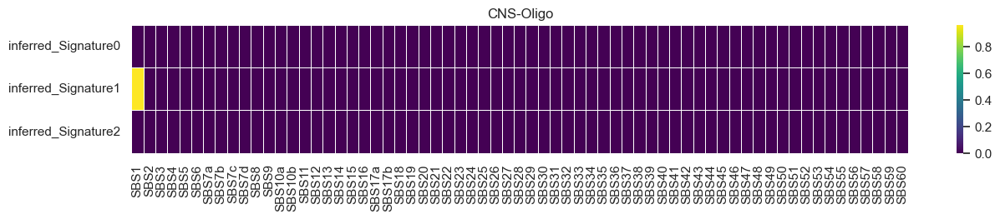

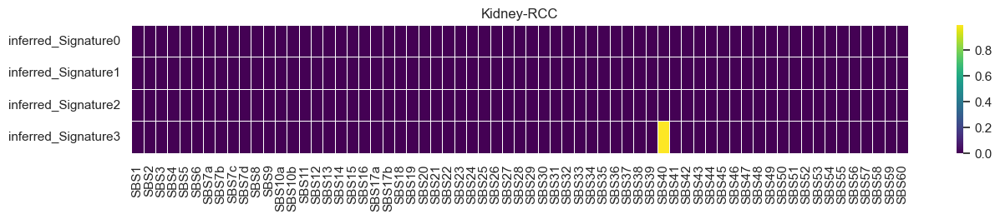

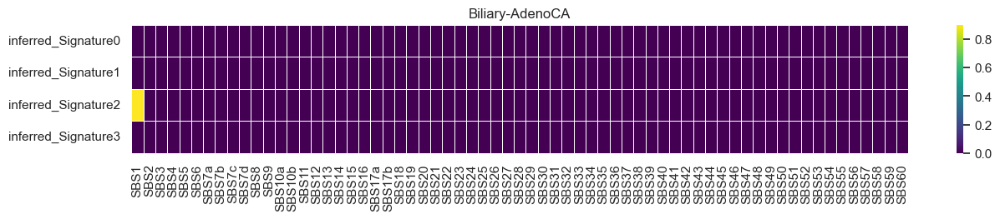

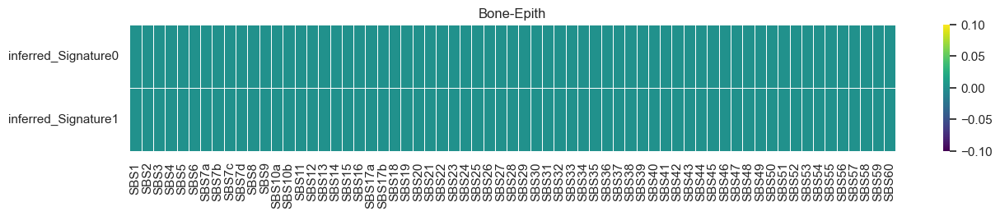

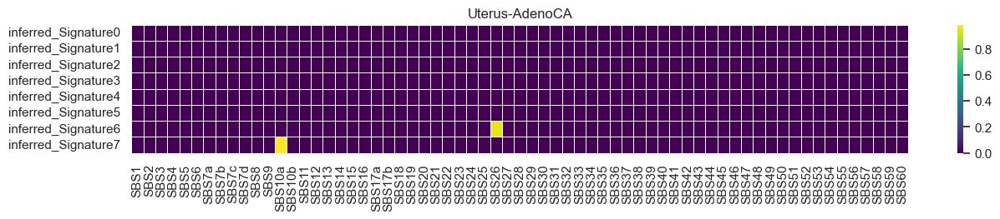

...

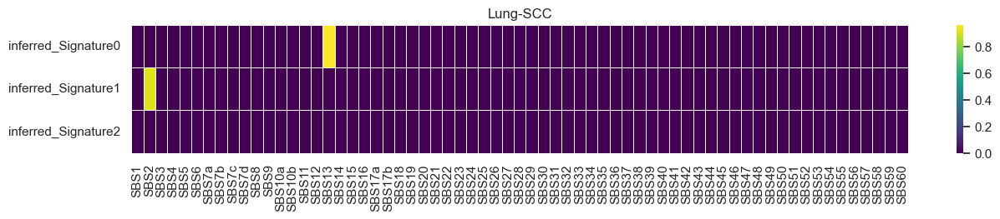

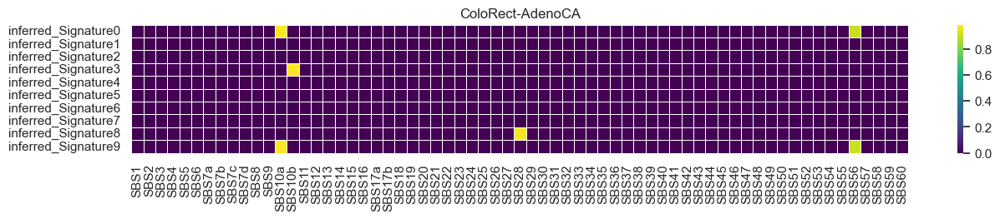

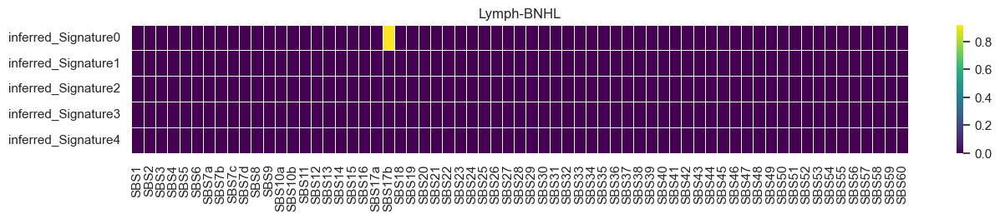

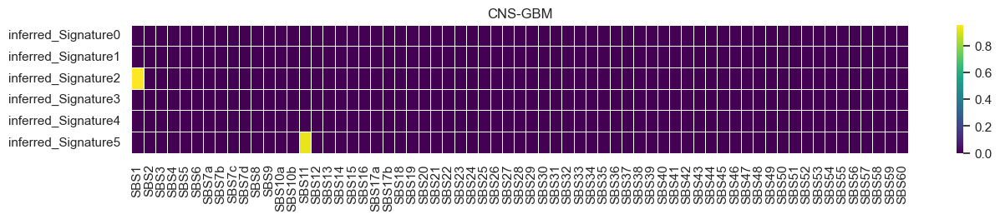

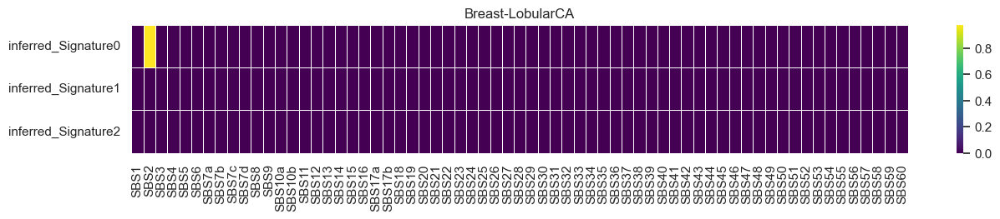

In [34]:
# make the heatplot for each cancer type to compare the inferred signatures with the known signatures

for cancer_type, sim in signature_comparison_results.items():
    sns.set(rc={"figure.figsize":(15,2)})
    sns.heatmap(sim, linewidth = 0.5, cmap = 'viridis', xticklabels = SBS_sig.columns[2:].values, 
                 yticklabels =  ["inferred_Signature" + str(i) for i in range(sim.shape[0])])
    plt.title(cancer_type)
    plt.show()



In [35]:
# print the best k for each cancer type
for cancer_type, best_k in best_k_for_cancer_type.items():
    print(f"The best number of components for {cancer_type} is: {best_k}")
    

The best number of components for CNS-Oligo is: 3
The best number of components for Kidney-RCC is: 4
The best number of components for Biliary-AdenoCA is: 4
The best number of components for Bone-Epith is: 2
The best number of components for Uterus-AdenoCA is: 8
The best number of components for Cervix-SCC is: 3
The best number of components for Panc-Endocrine is: 7
The best number of components for Eso-AdenoCA is: 6
The best number of components for Breast-DCIS is: 7
The best number of components for Bladder-TCC is: 3
The best number of components for Prost-AdenoCA is: 3
The best number of components for Cervix-AdenoCA is: 3
The best number of components for Skin-Melanoma is: 3
The best number of components for Myeloid-MDS is: 6
The best number of components for Kidney-ChRCC is: 3
The best number of components for SoftTissue-Leiomyo is: 1
The best number of components for CNS-Medullo is: 2
The best number of components for CNS-PiloAstro is: 2
The best number of components for Breast-A

the result is quite bad so lets try different method to find the best signature number


I'll use method described in :L. Alexandrov, J. Kim, N. Haradhvala, M. Huang, A. Ng, Y. Wu, A. Boot, K. Covington, D. Gordenin, E. Bergstrom, S. Islam, N. L´opez-Bigas, L. Klimczak, J. McPherson, S. Morganella, R. Sabarinathan, D. Wheeler, V. Mustonen, P. Boutros, and W. Yu. The repertoire of mutational signatures in human cancer. Nature, 578:94–101, 02 2020. 

And I'll use the code from https://github.com/GalGilad/CV2K.git with slight changes to fit my needs.


In [36]:
import argparse
import numpy as np
from CV2K_main import CV2K # import the CV2K function from the CV2K_main.py file in the same directory
def find_best_k(data):
    """Find the best number of components for NMF using CV2K."""
    args = argparse.Namespace(
        version='standard', # using only the standard version of the CV2K algorithm
        # other parameters are just the default parameters
        auto='n',
        data=data,  # data from the input
        fraction=0.1,
        reps=30,
        maxiter=2000,
        bottom_k=1,
        top_k=10,
        stride=1,
        workers=20,
        obj='kl',
        reg=0
    ) ## this is propably redundant
    best_k = CV2K(data, args)
    return best_k



First let's test the code with the simulated data to see if it works.
We know for the simulated date we chose 4 signatures so we can use that as the best number of signatures.
If the code works the next code block should print out the best number of signatures as 4.

In [37]:
print(f"Best number of components : {find_best_k(simulated_dataset_heidi)}")
# this took quite long time to run in the csc environment, so be aware of that


Best number of components : 4


YAY it works <3

1. We extract the mutational counts for each cancer type from the data set (somaticMutations)
2. We "learn" the optimal number k of the mutational signatures using the method described in the paper
3. We apply the learned k components to the NMF algorithm to extract the mutational signatures
4. Normalize the signatures to probability densities and plot them
5. Compare the learned signatures to the known signatures using cosine similarity

Processing CNS-Oligo


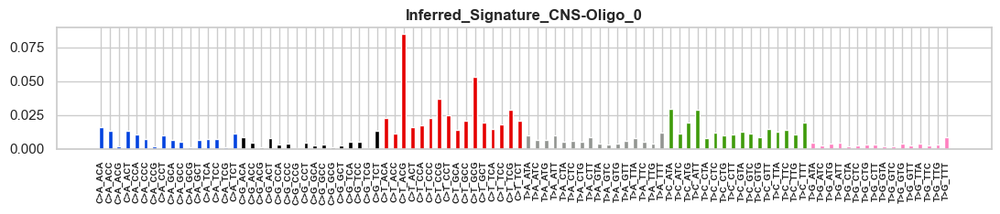

Processing Kidney-RCC


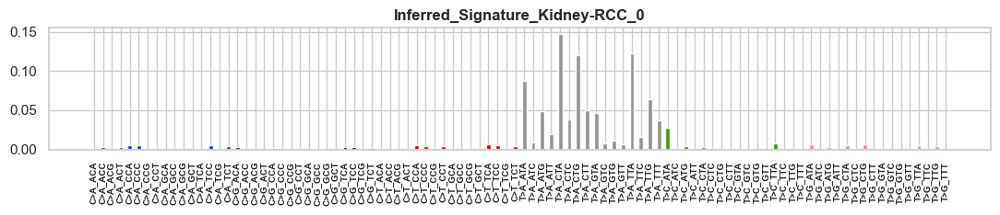

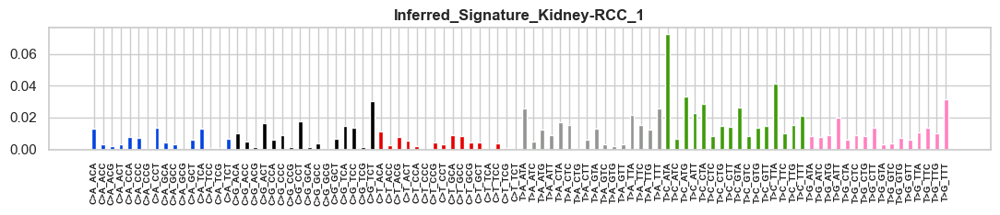

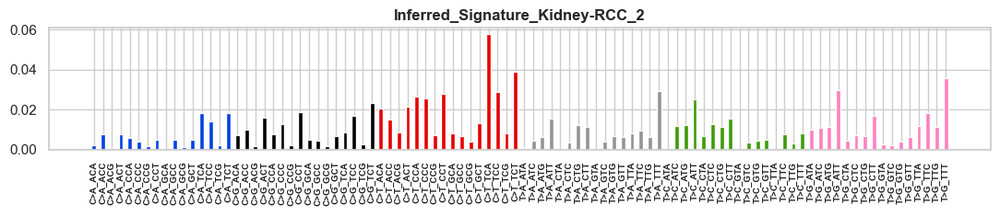

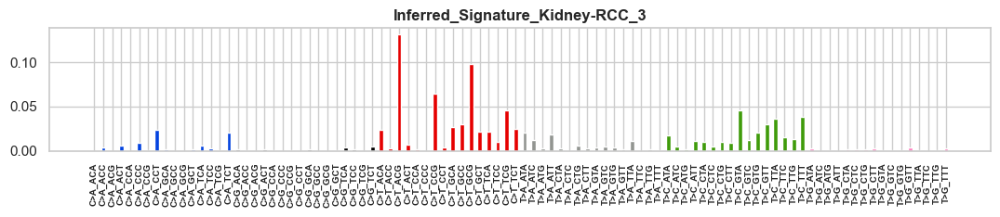

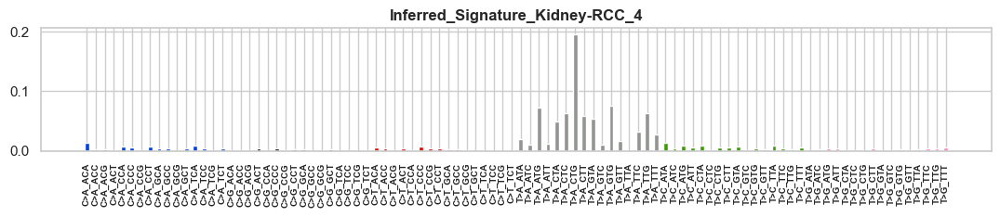

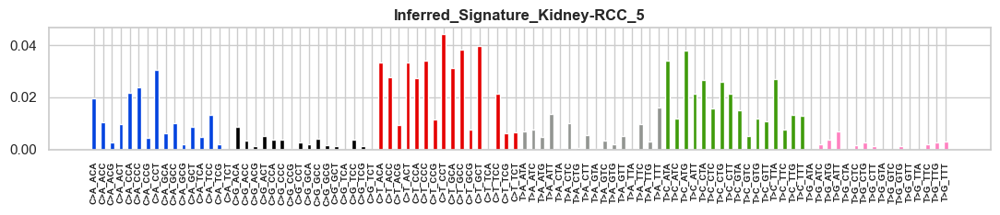

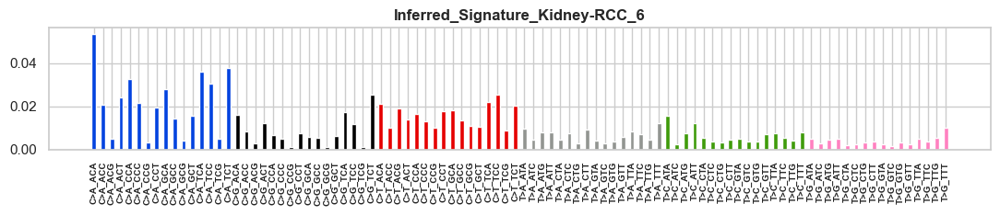

Processing Biliary-AdenoCA


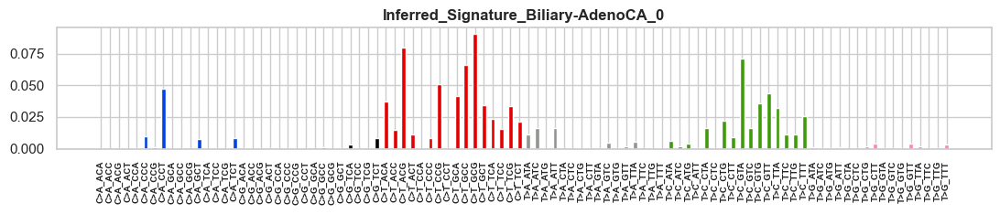

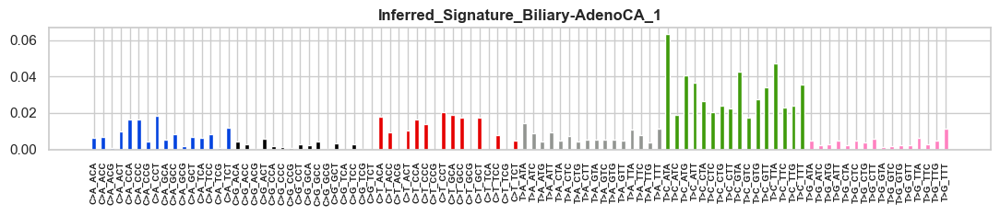

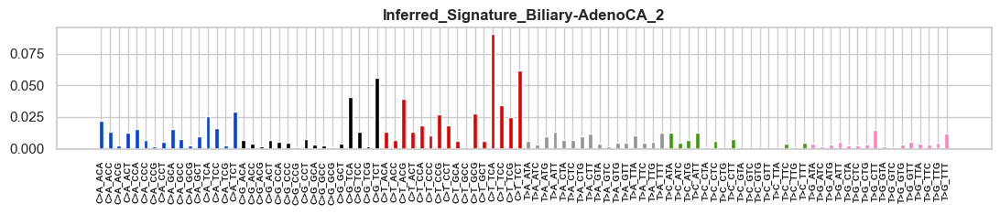

Processing Bone-Epith


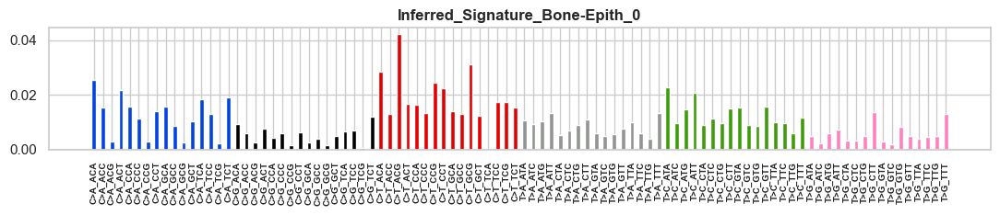

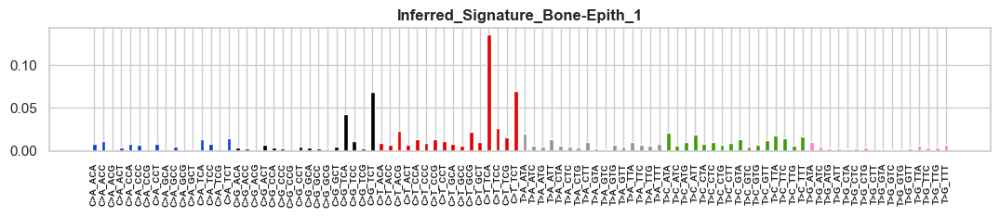

Processing Uterus-AdenoCA


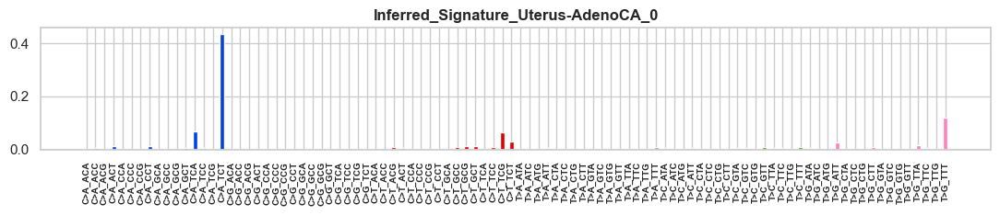

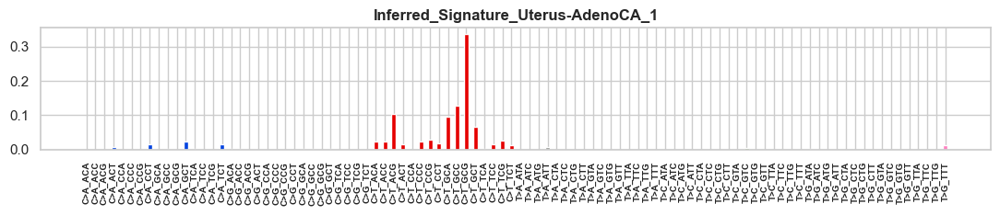

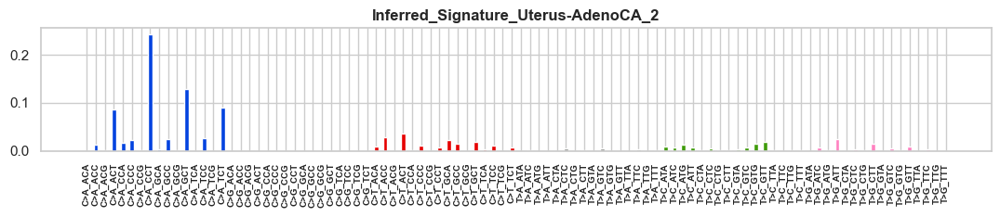

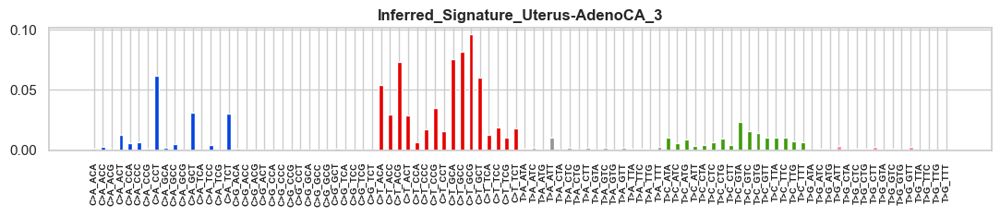

Processing Cervix-SCC


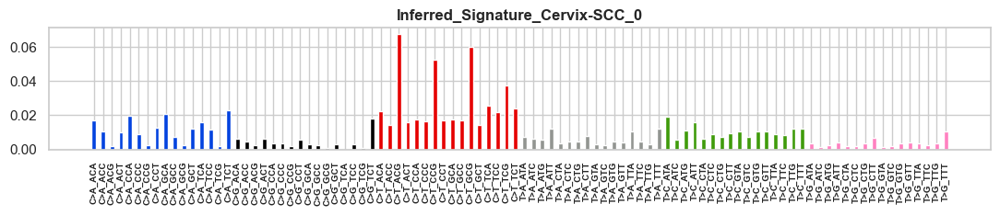

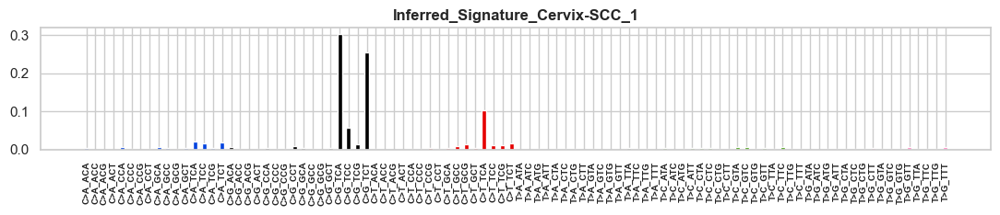

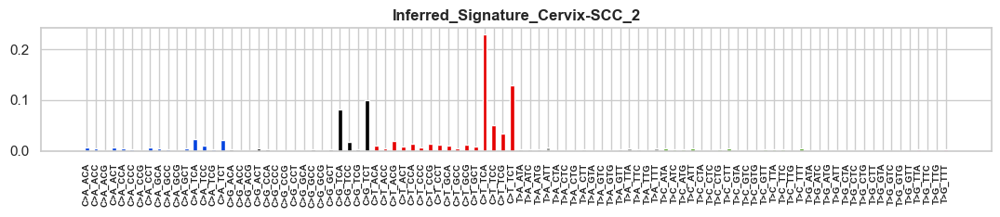

Processing Panc-Endocrine


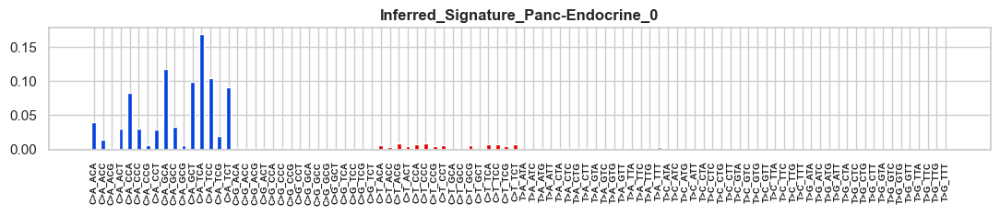

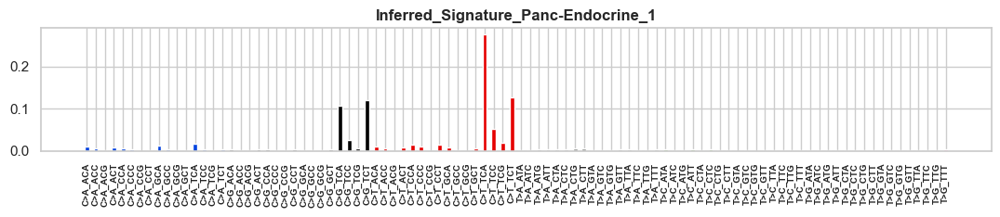

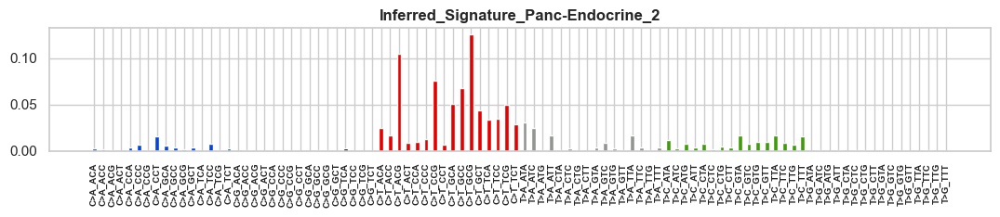

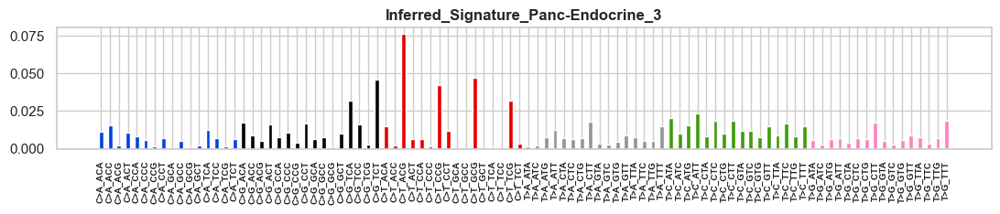

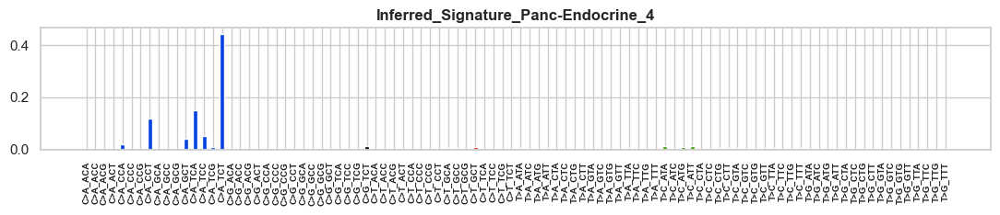

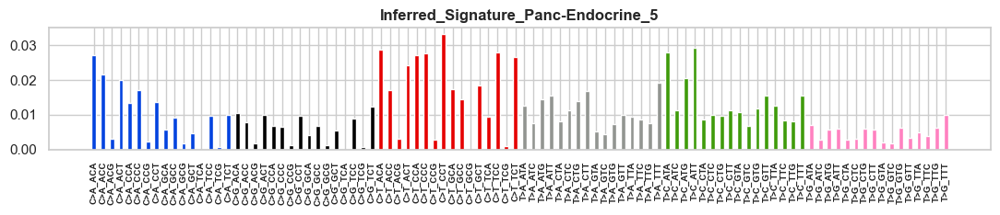

Processing Eso-AdenoCA


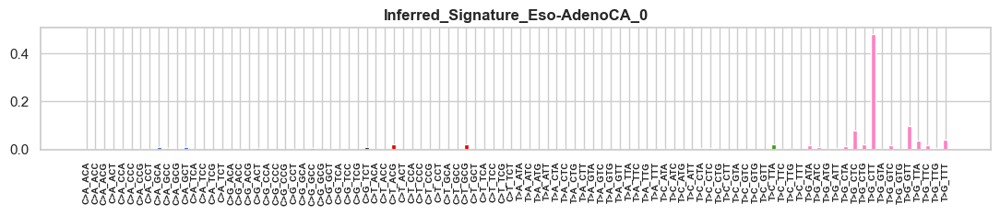

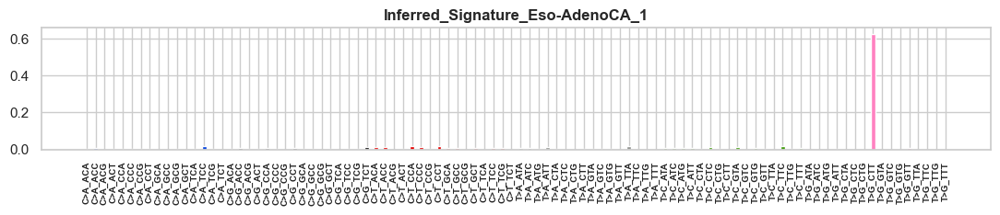

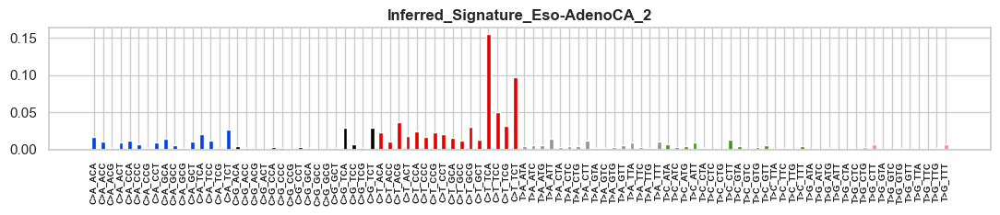

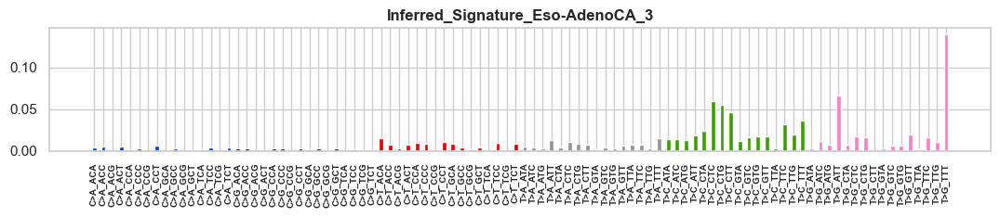

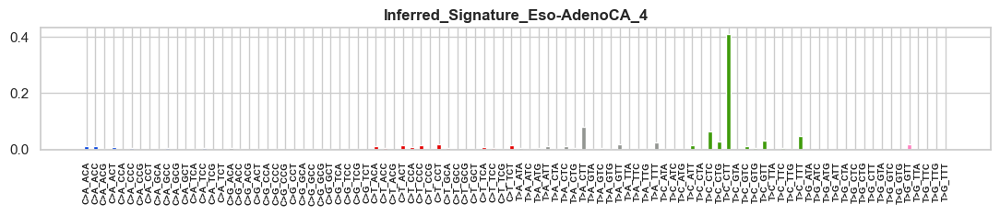

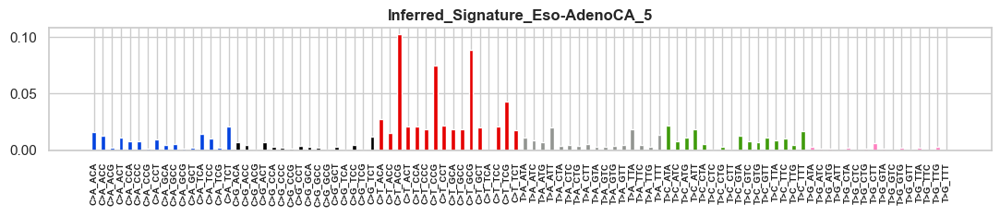

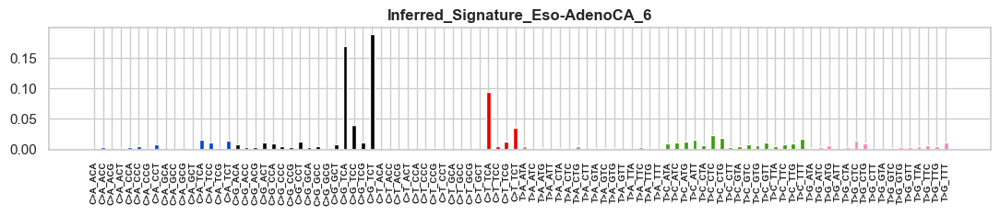

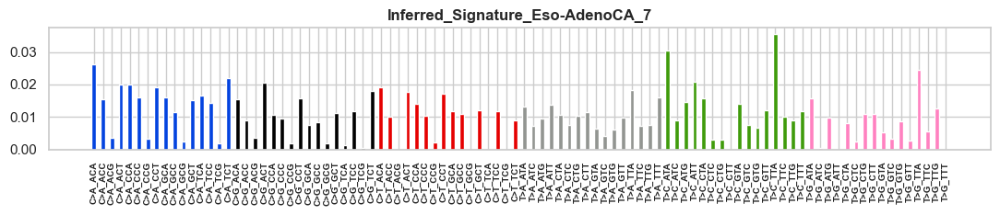

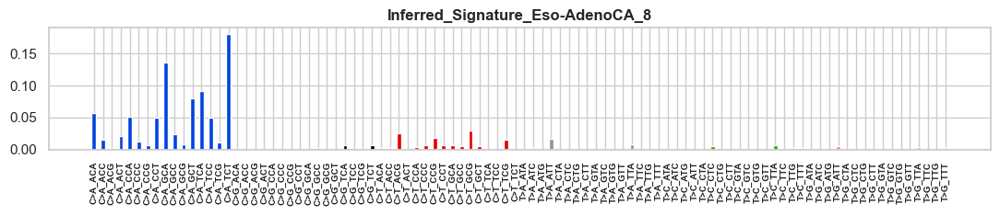

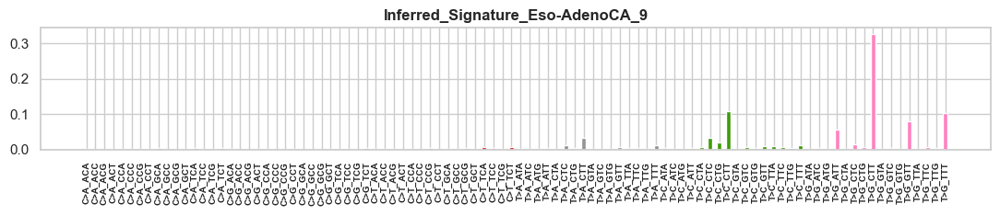

Processing Breast-DCIS


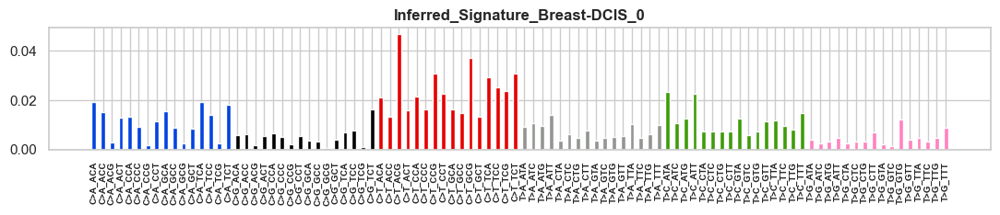

Processing Bladder-TCC


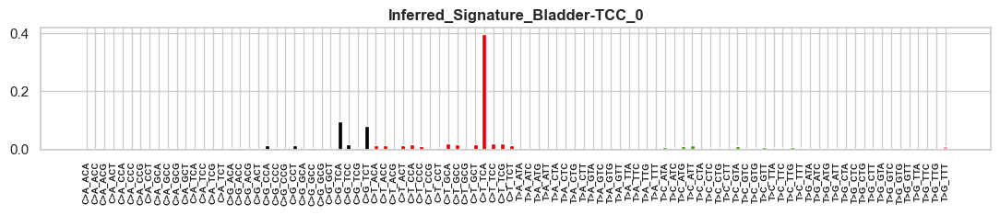

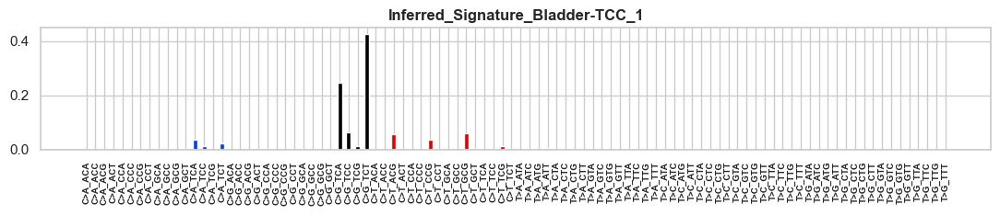

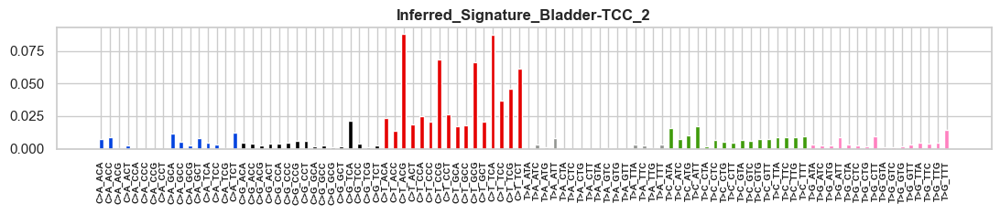

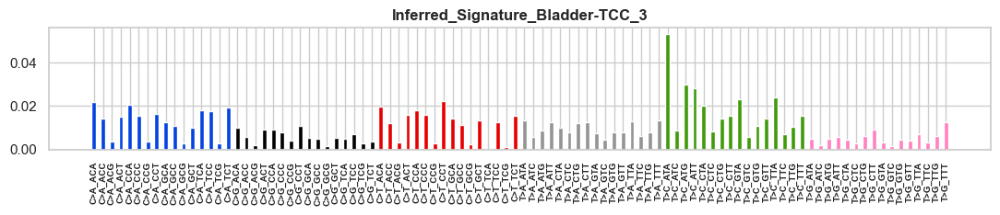

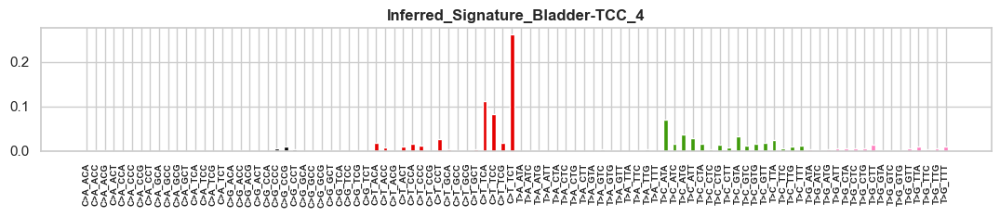

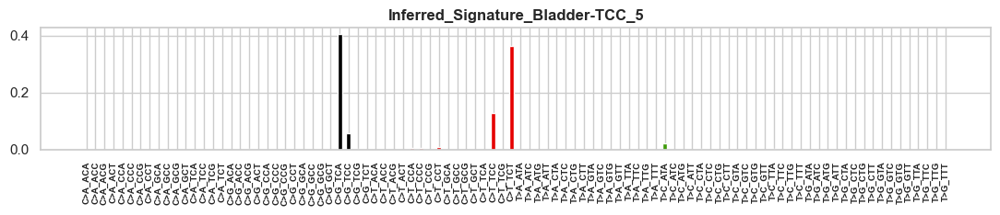

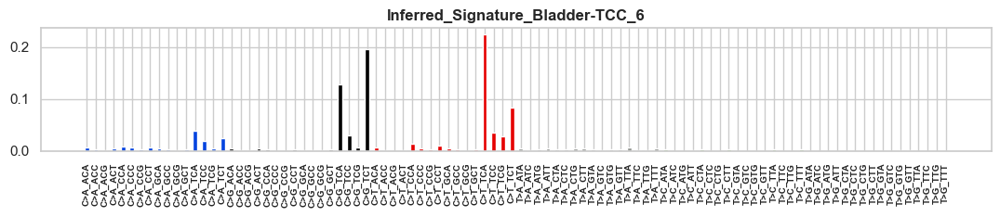

Processing Prost-AdenoCA


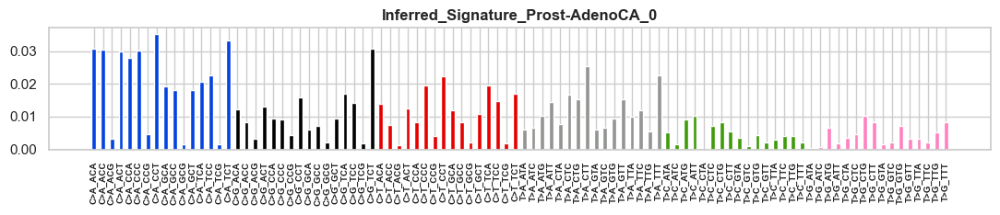

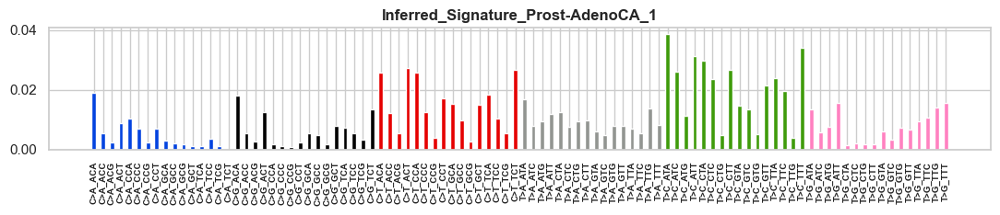

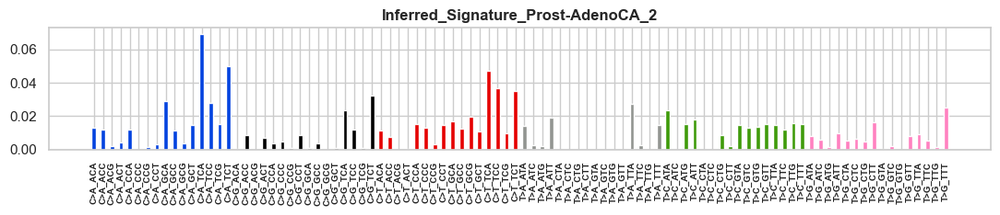

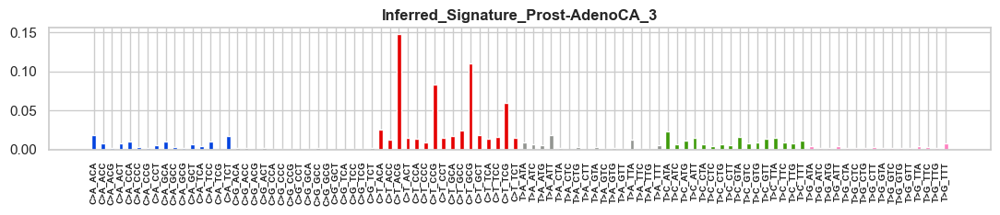

Processing Cervix-AdenoCA


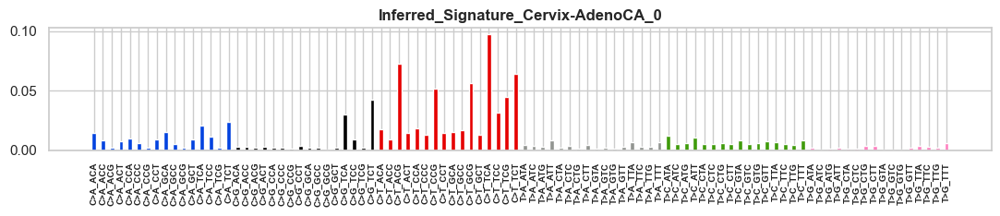

Processing Skin-Melanoma


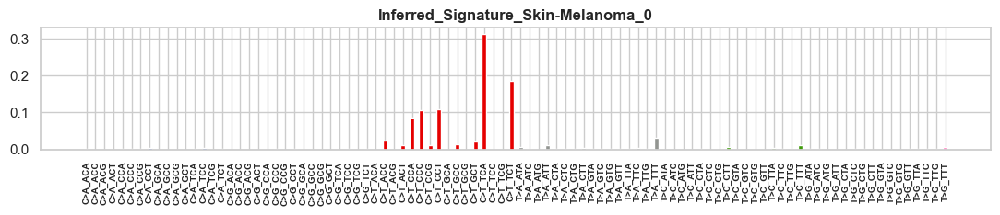

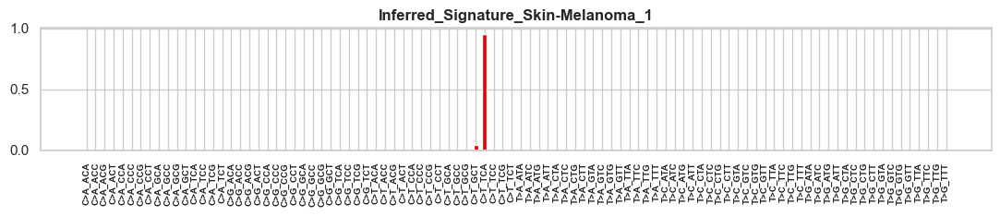

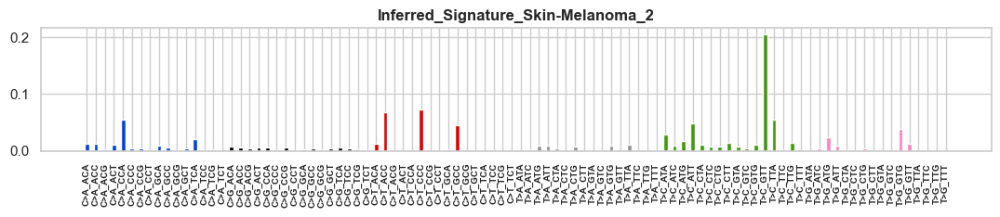

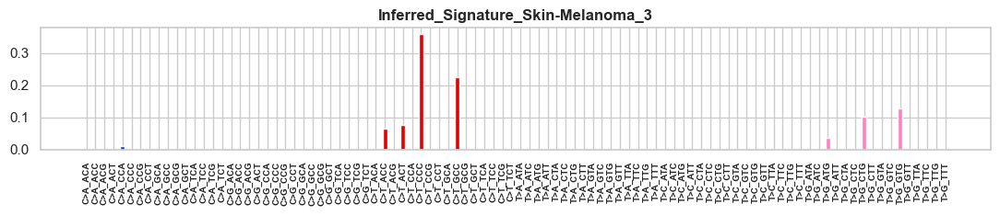

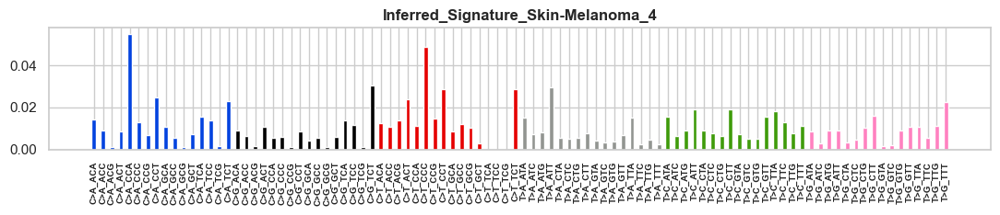

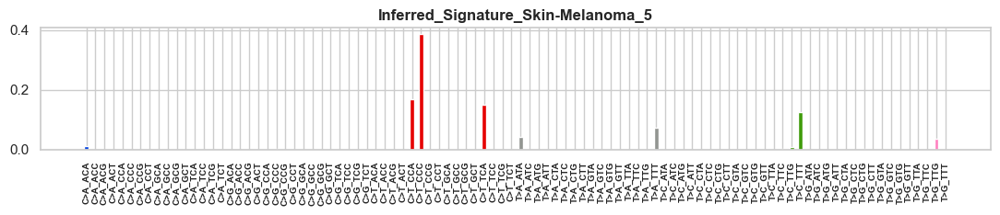

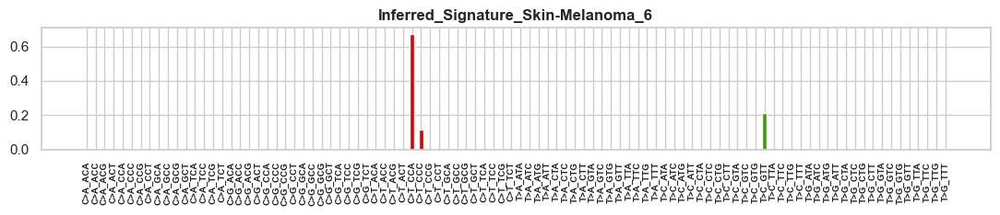

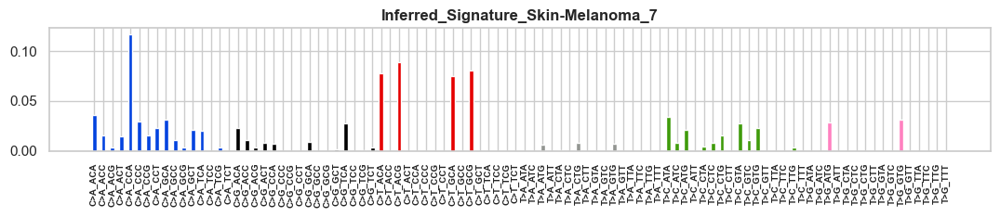

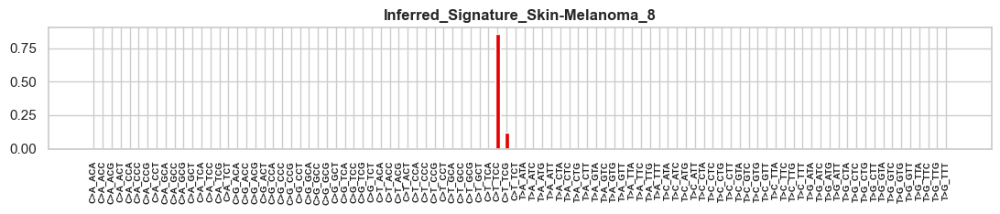

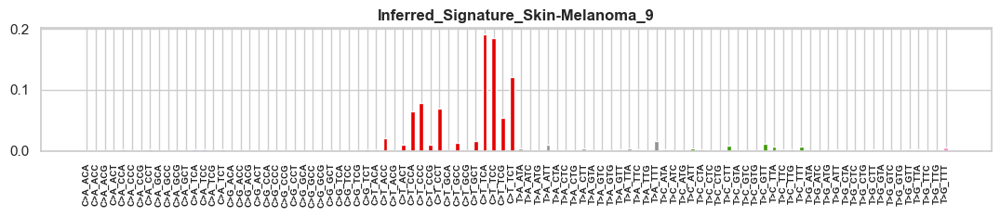

Processing Myeloid-MDS


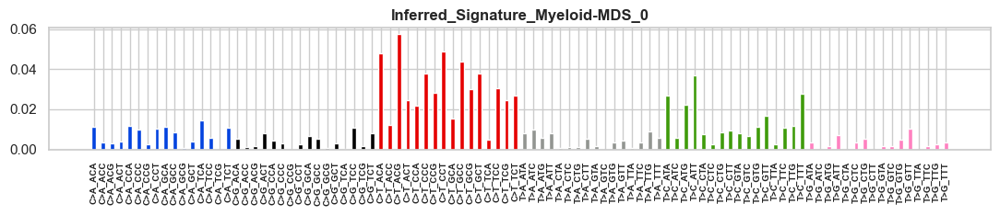

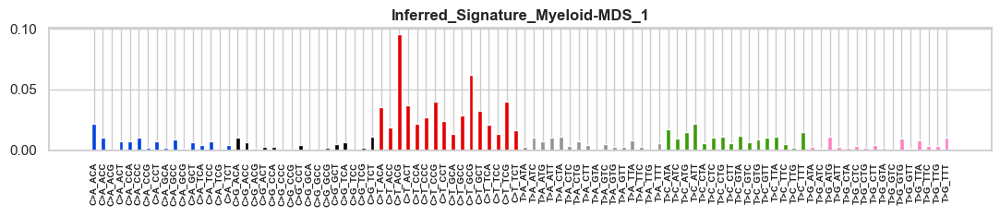

Processing Kidney-ChRCC


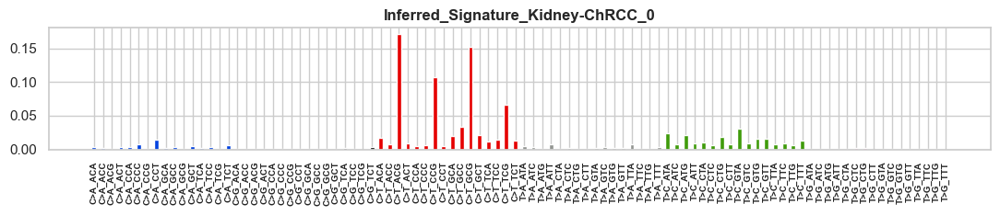

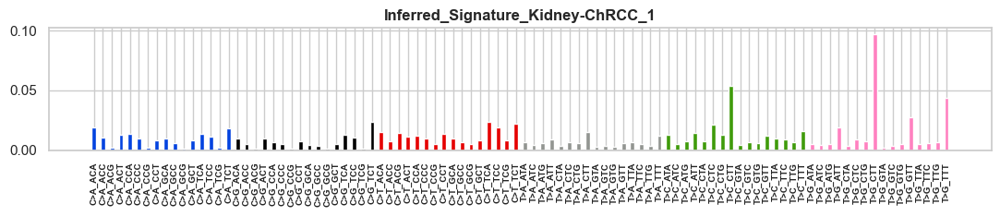

Processing SoftTissue-Leiomyo


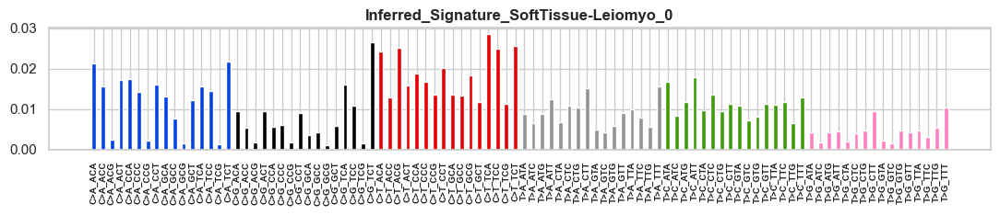

Processing CNS-Medullo


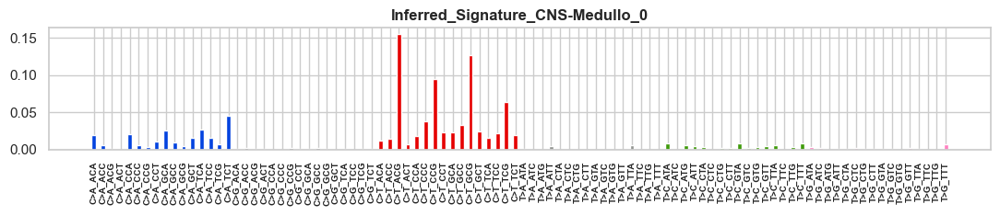

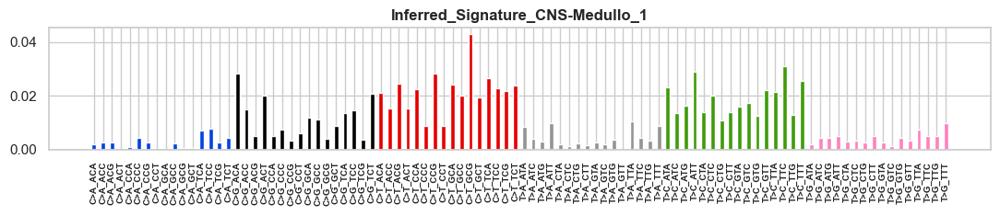

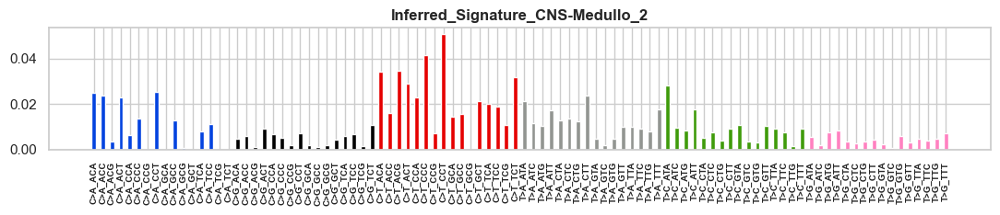

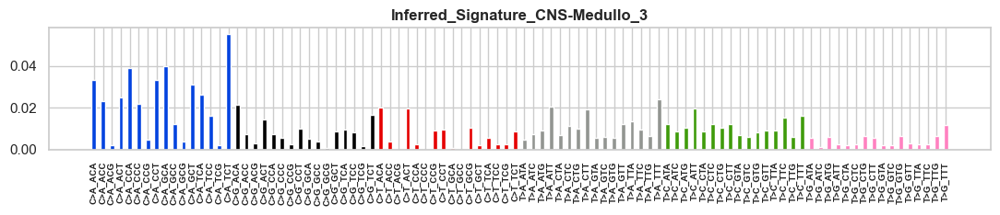

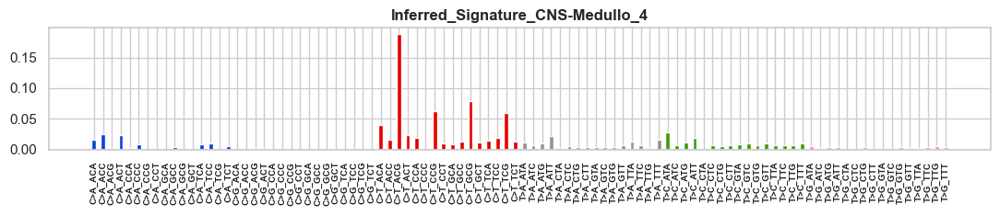

Processing CNS-PiloAstro


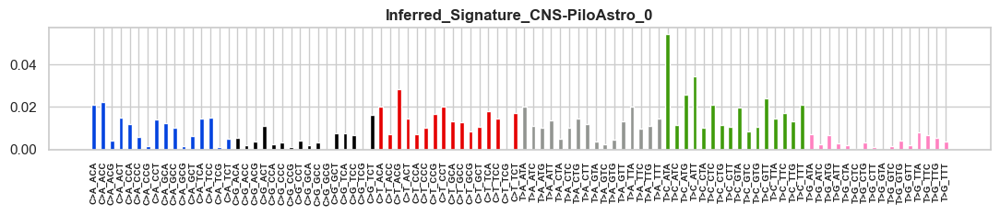

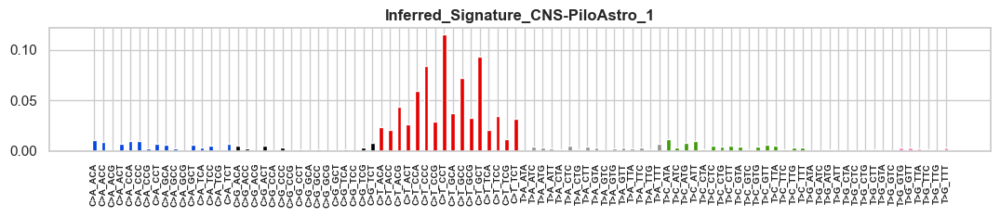

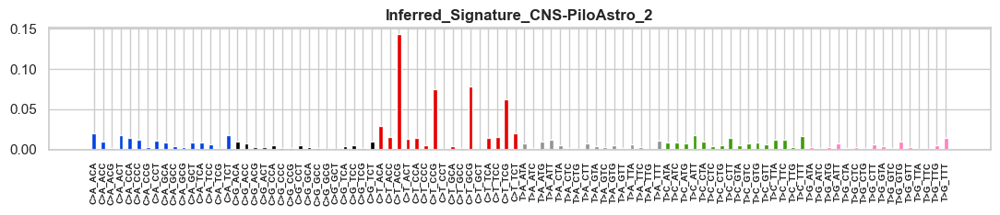

Processing Breast-AdenoCA


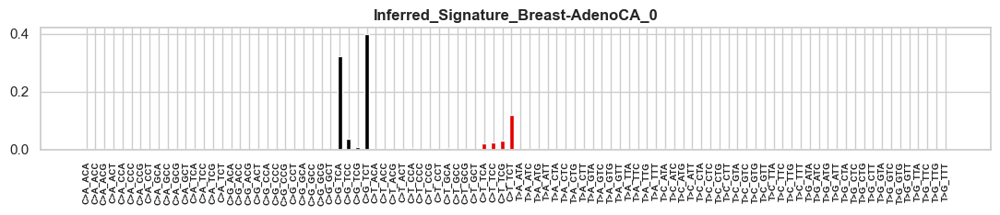

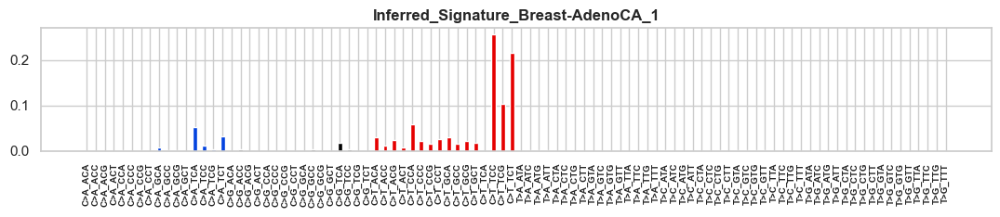

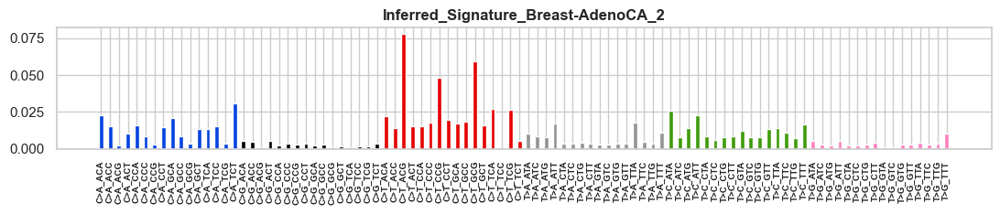

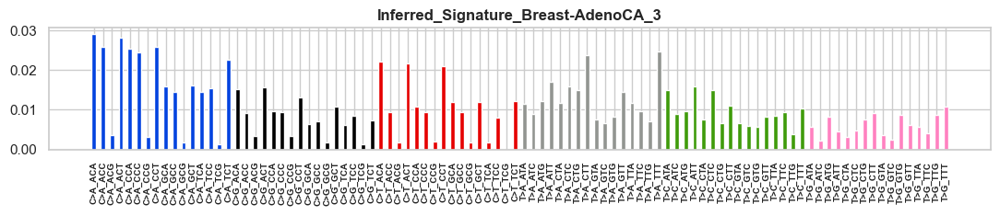

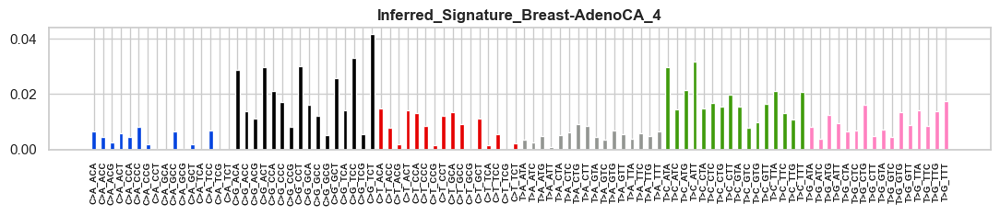

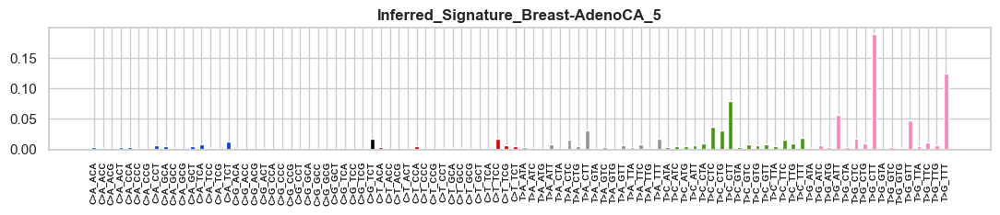

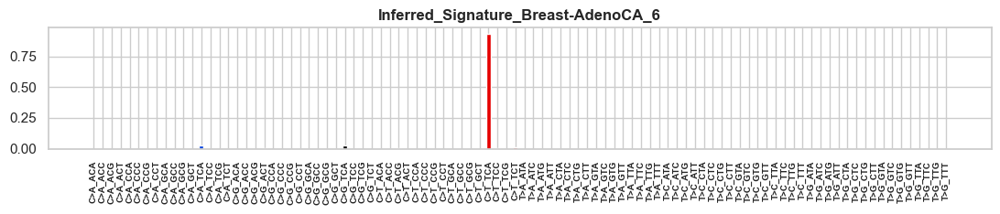

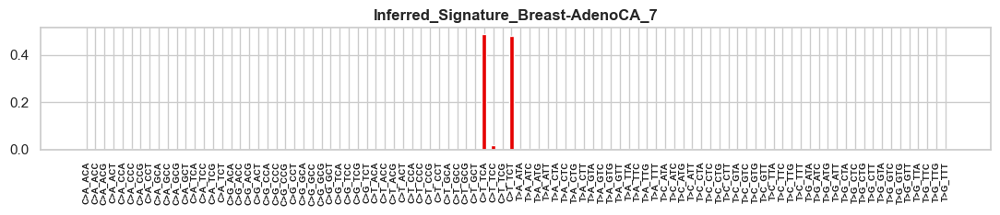

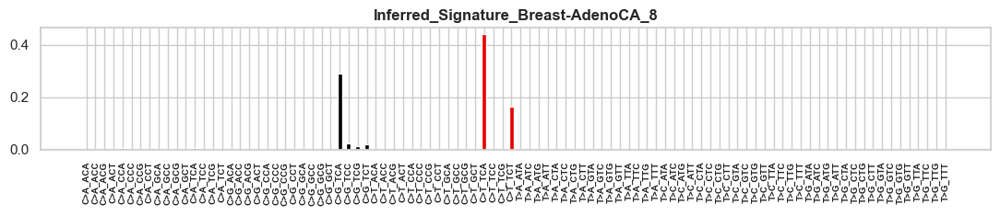

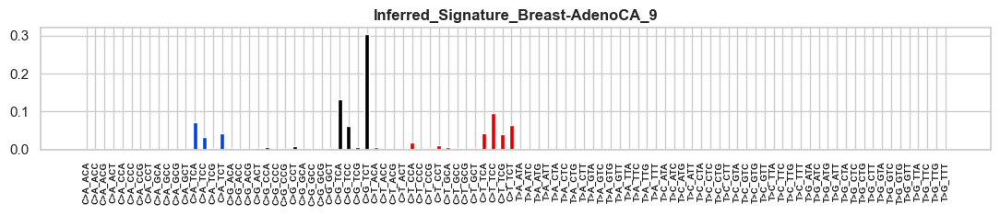

Processing Panc-AdenoCA


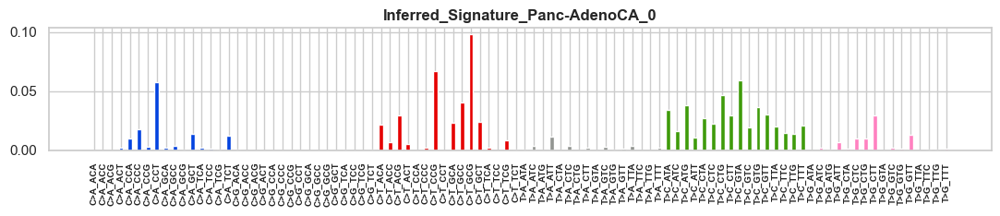

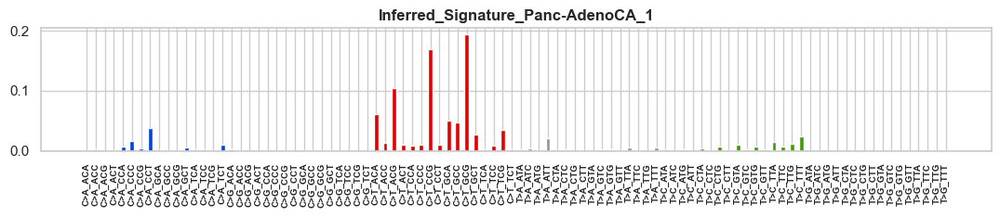

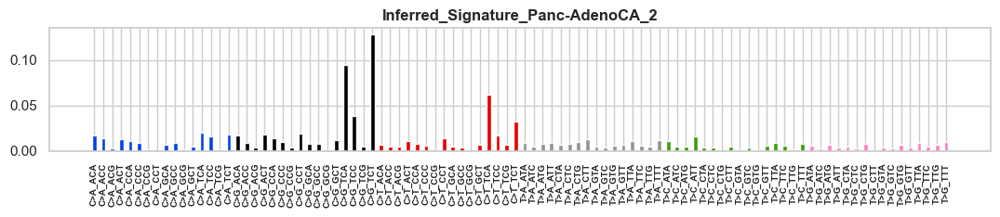

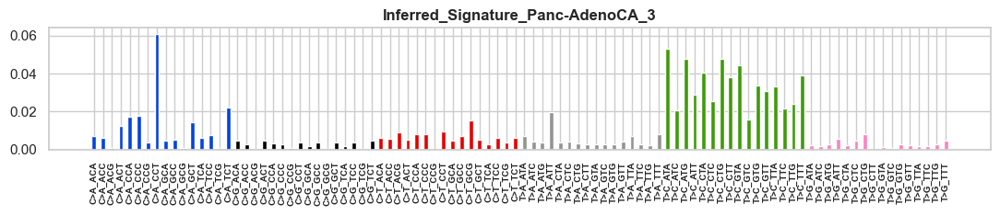

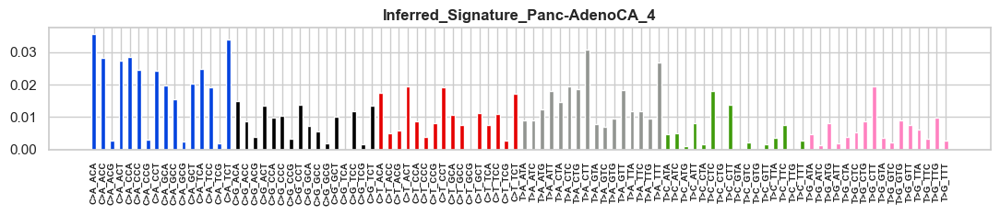

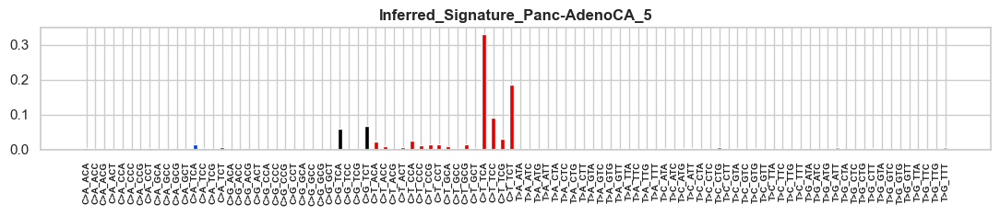

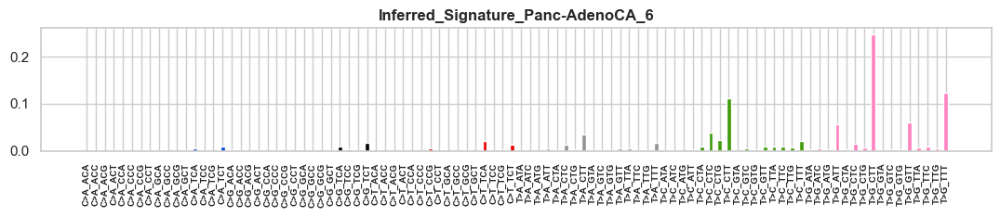

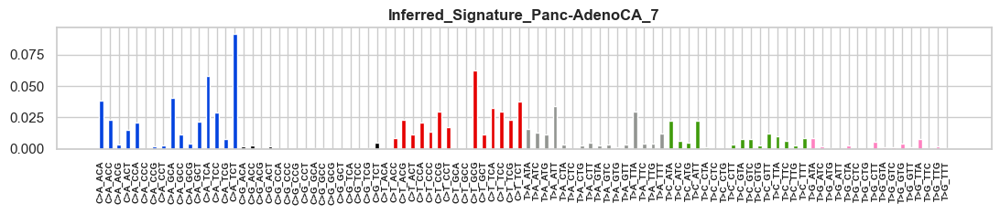

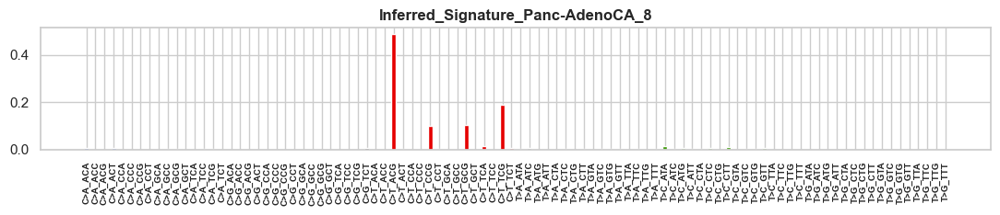

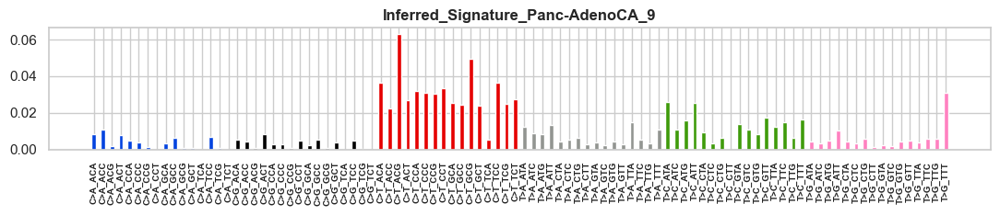

Processing Lung-AdenoCA


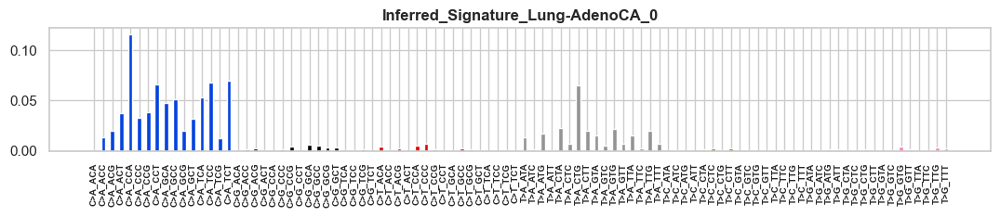

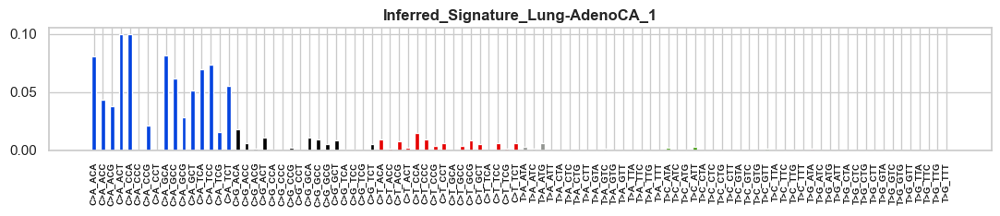

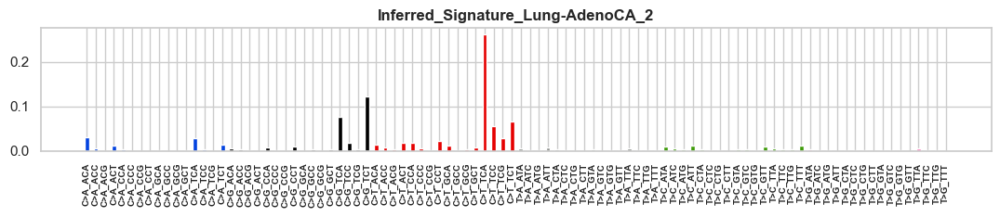

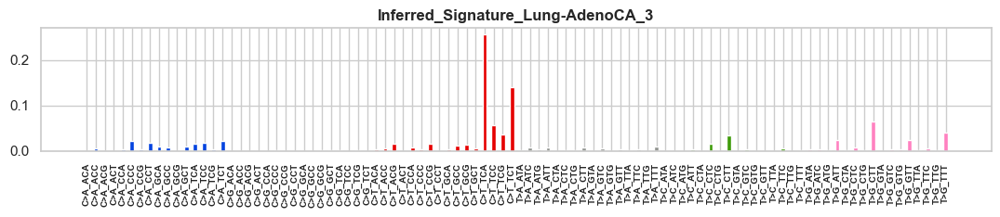

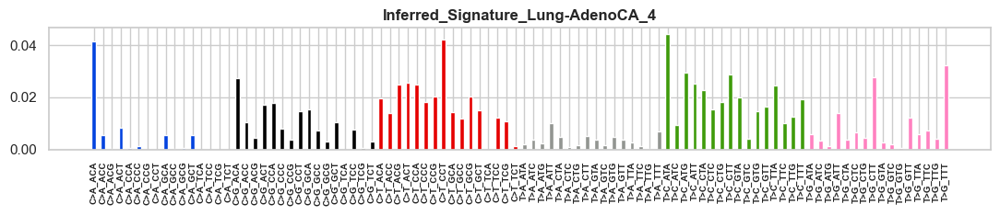

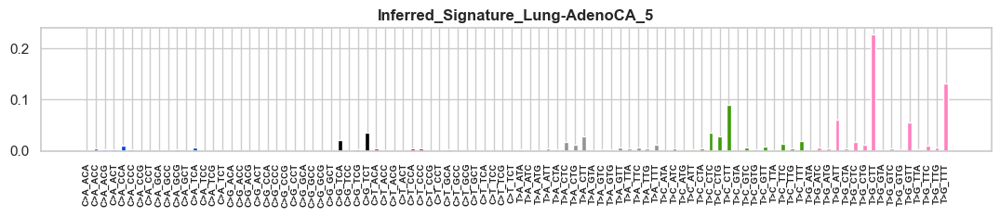

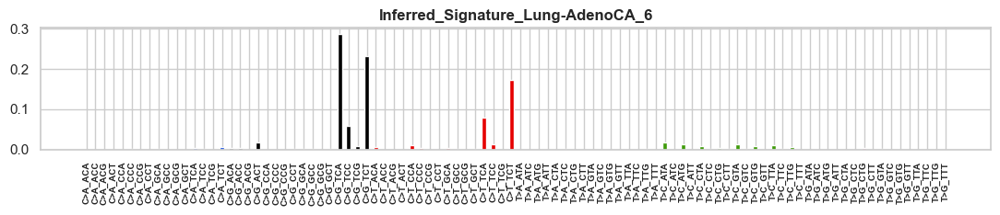

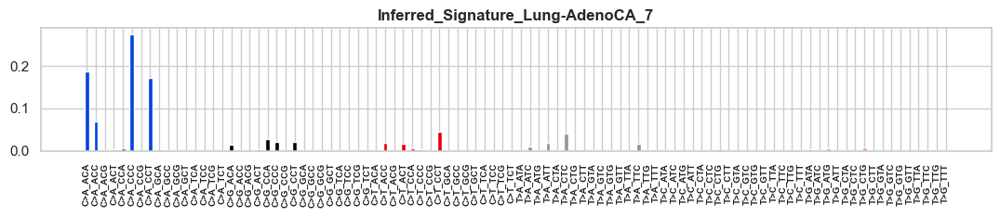

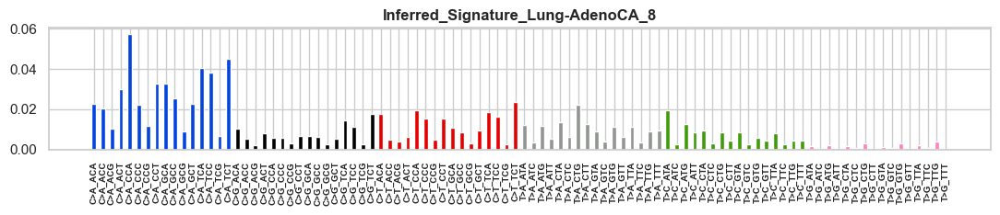

Processing Myeloid-MPN


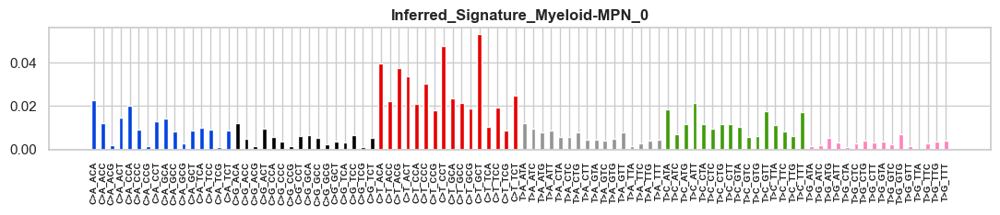

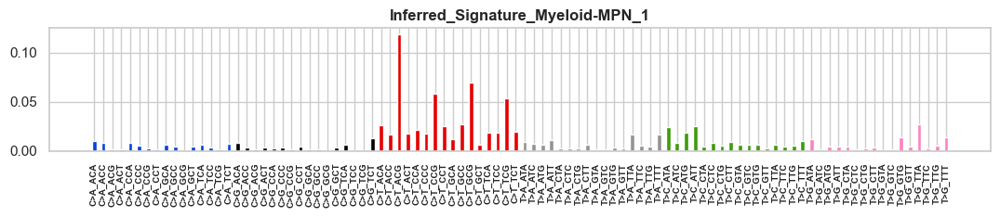

Processing Myeloid-AML


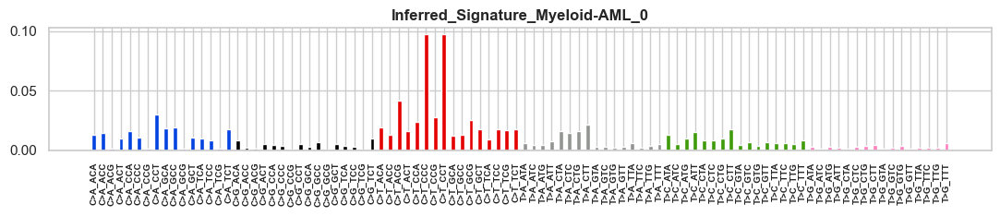

Processing Bone-Osteosarc


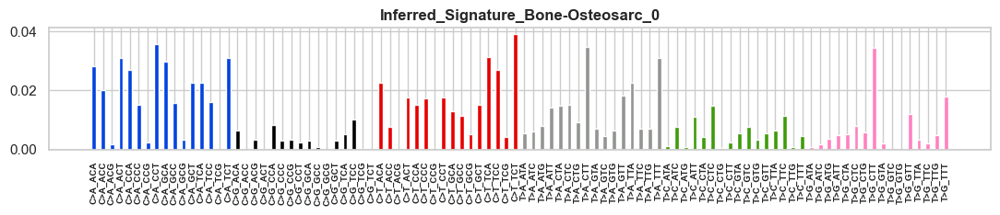

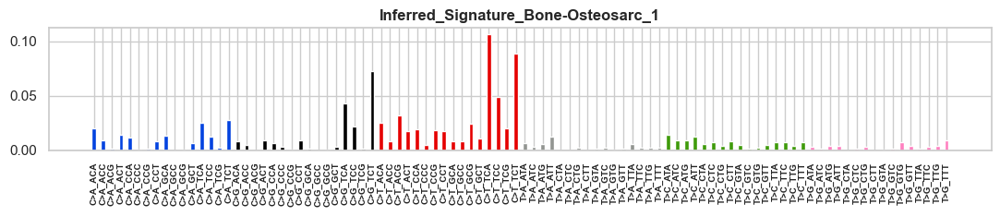

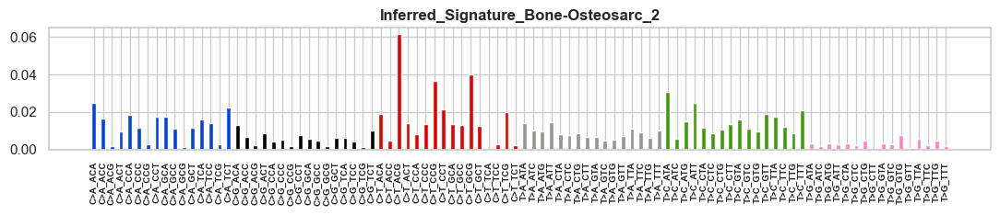

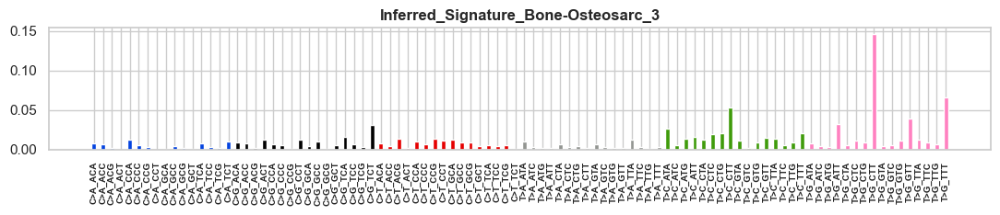

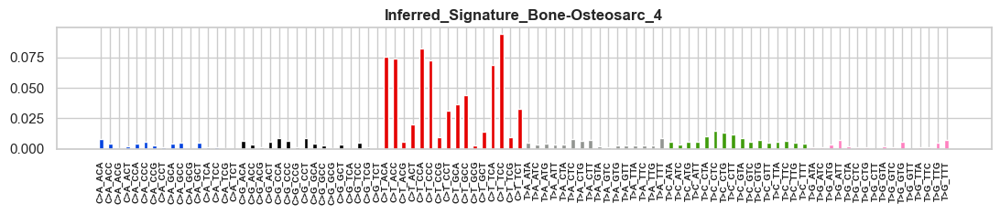

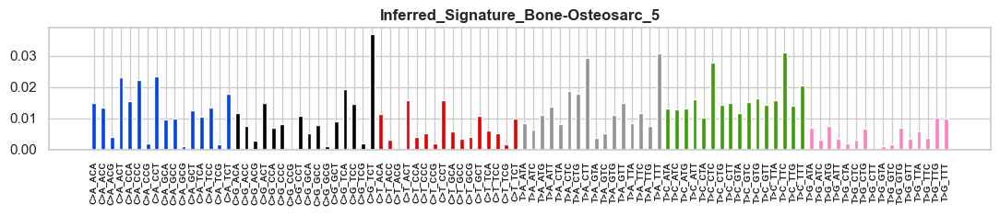

Processing SoftTissue-Liposarc


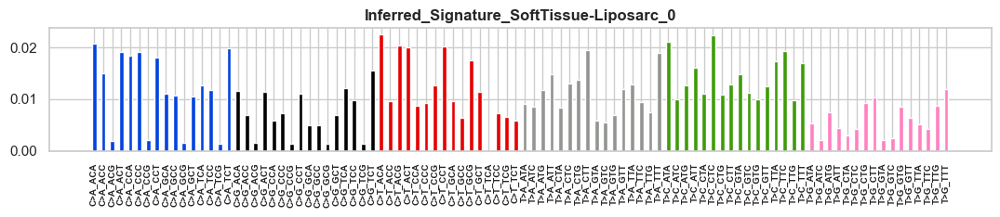

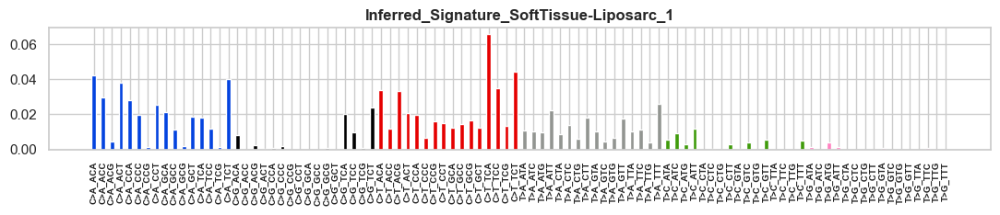

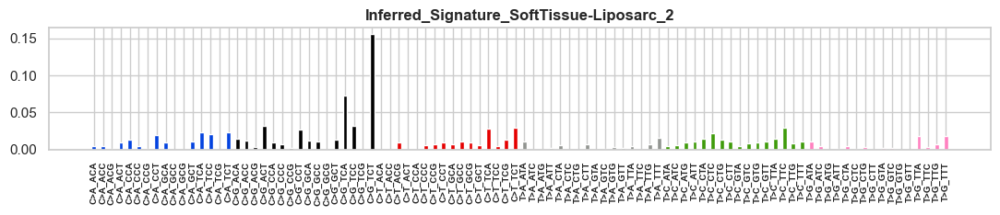

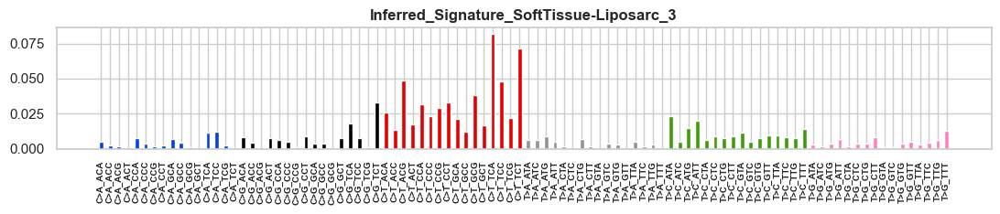

Processing Bone-Benign


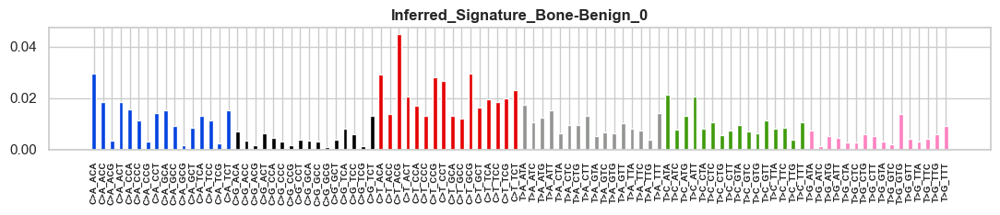

Processing Stomach-AdenoCA


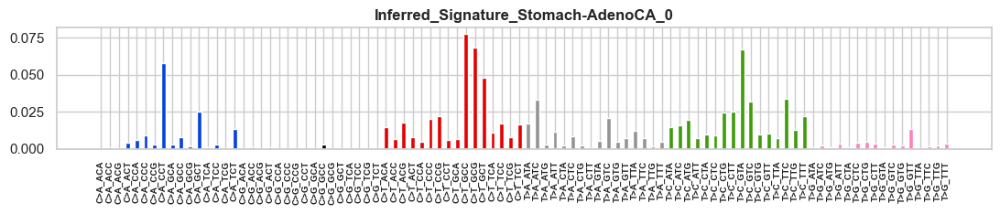

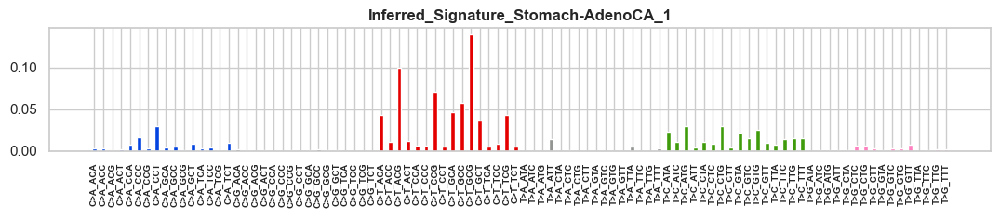

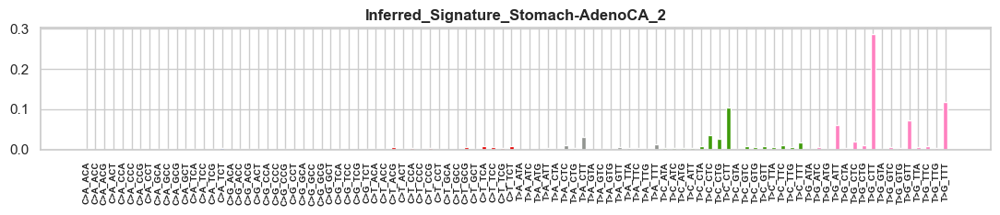

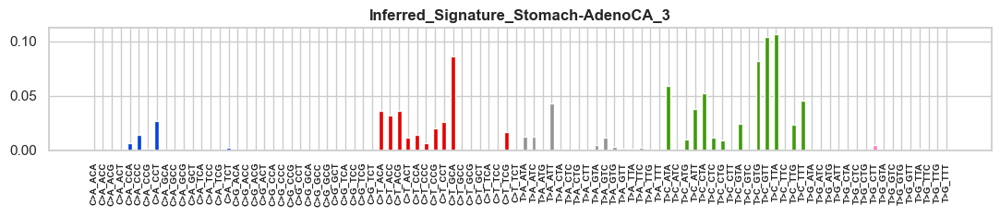

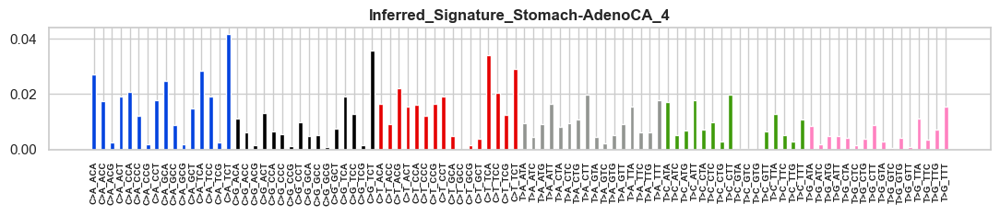

Processing Liver-HCC


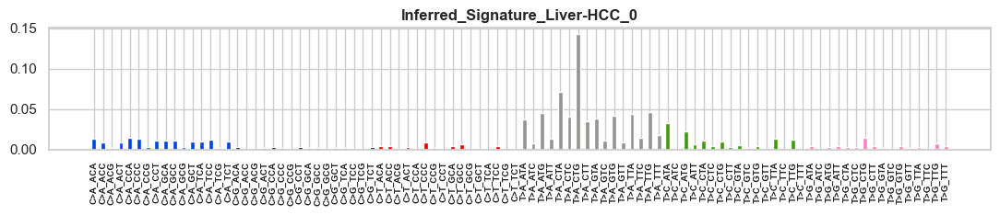

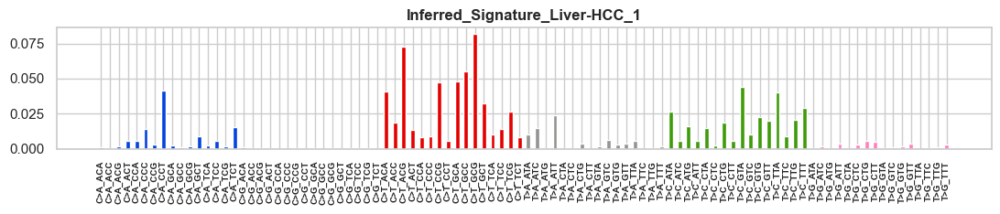

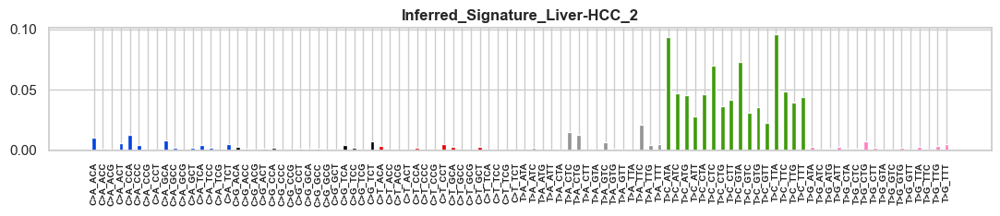

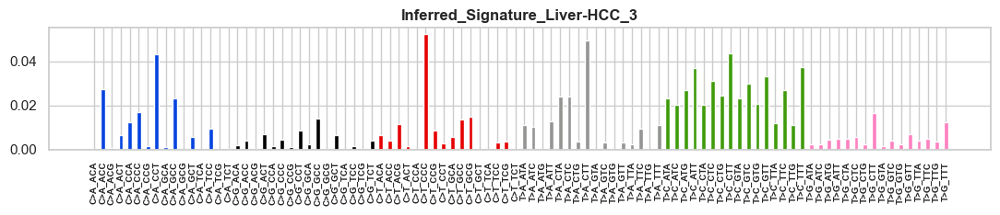

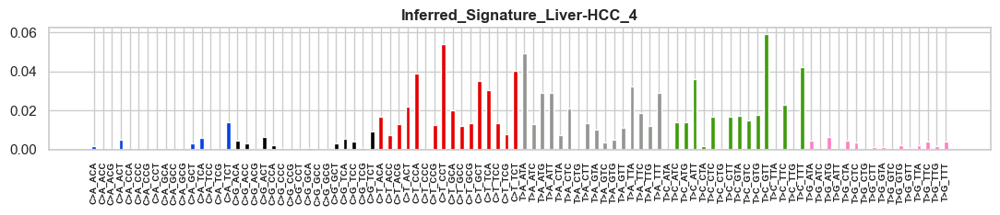

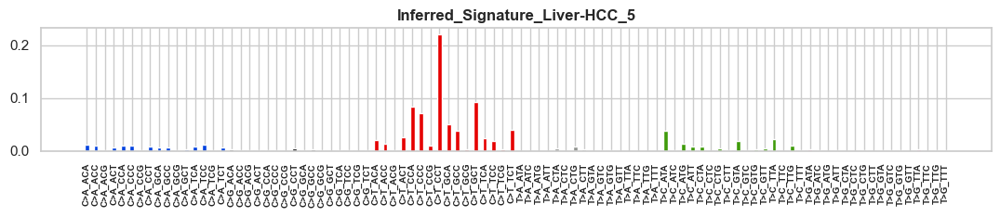

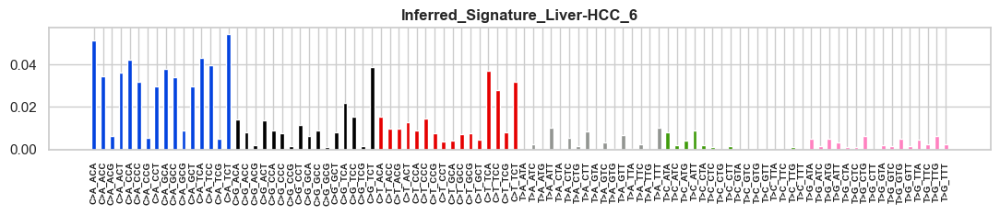

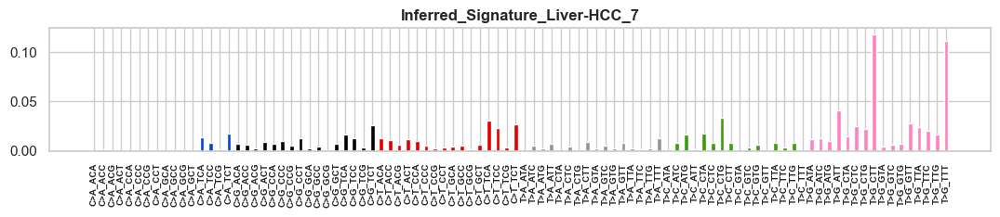

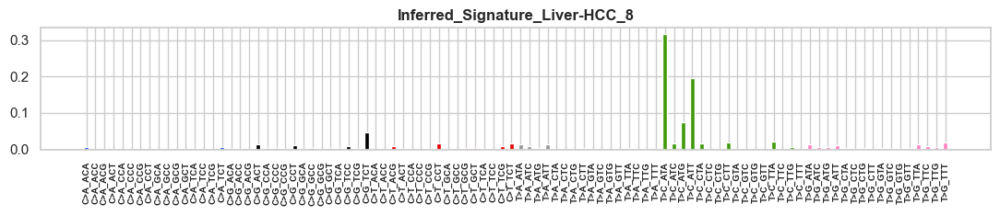

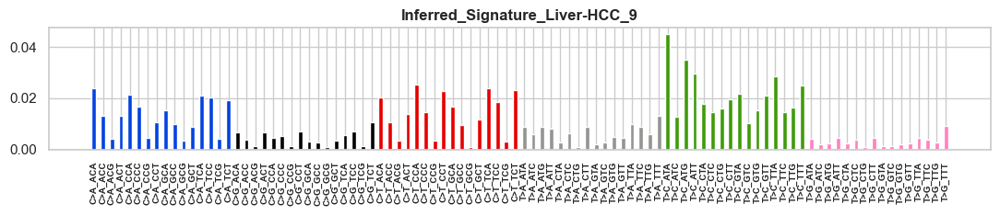

Processing Thy-AdenoCA


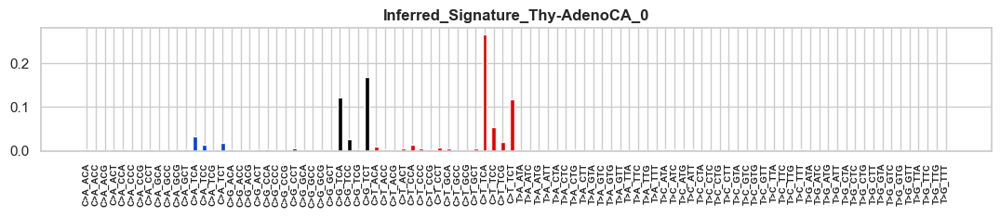

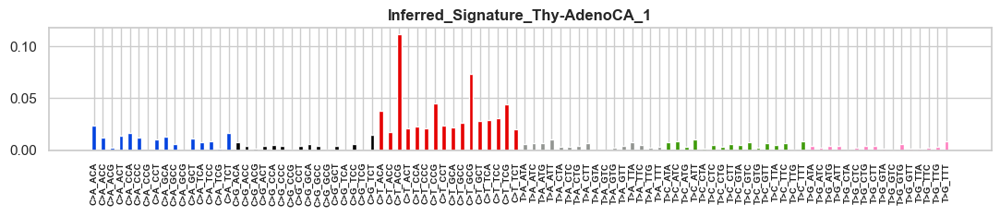

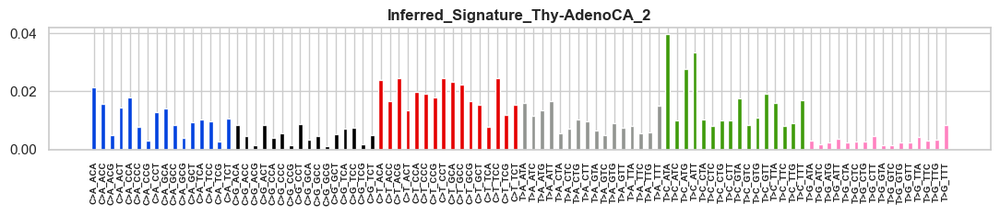

Processing Lymph-CLL


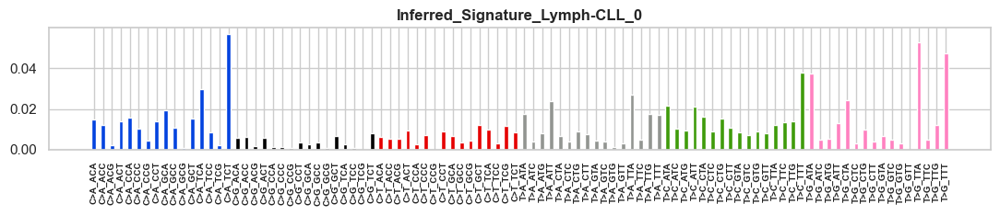

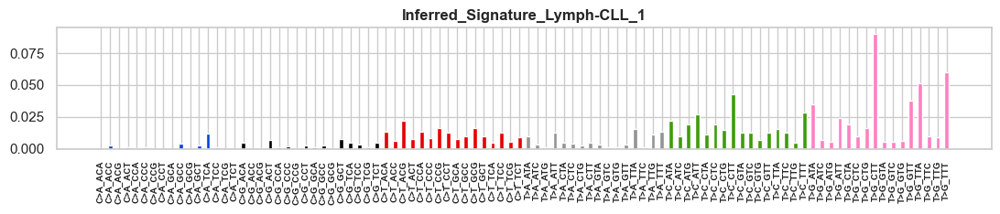

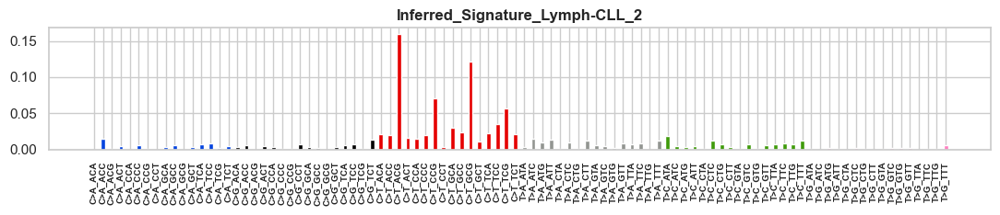

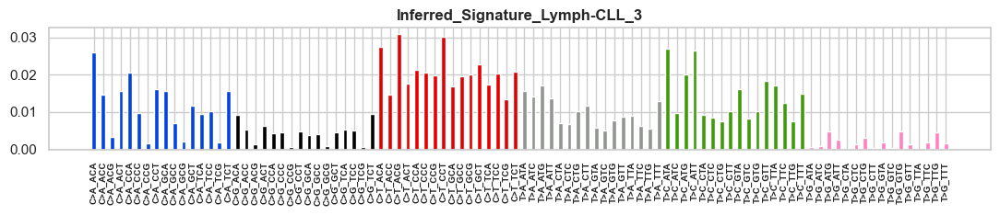

Processing Head-SCC


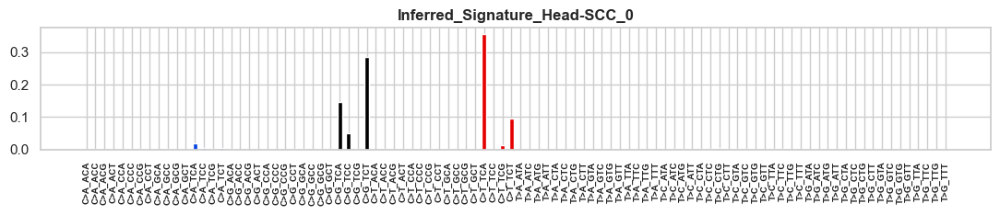

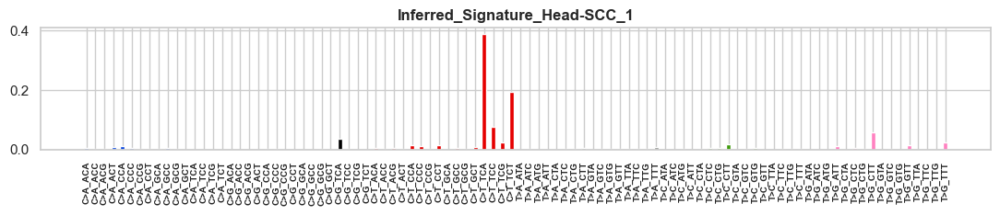

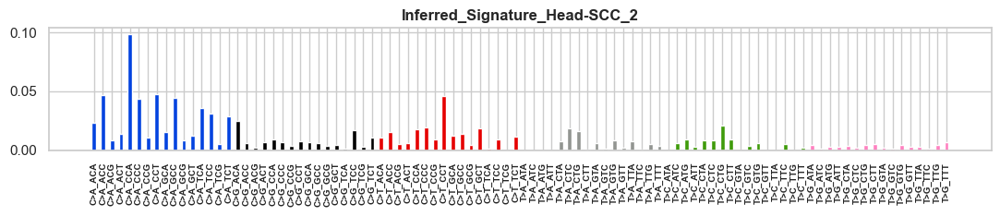

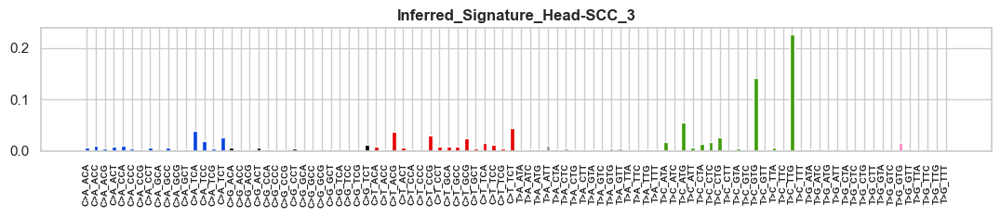

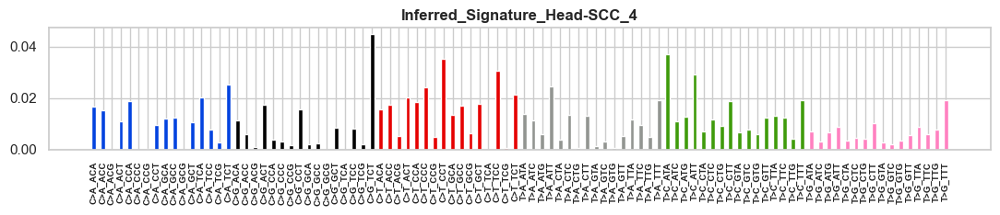

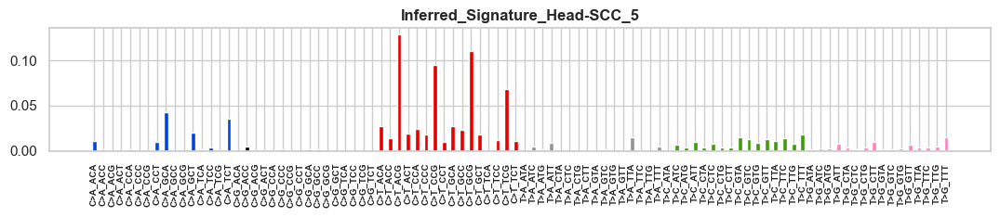

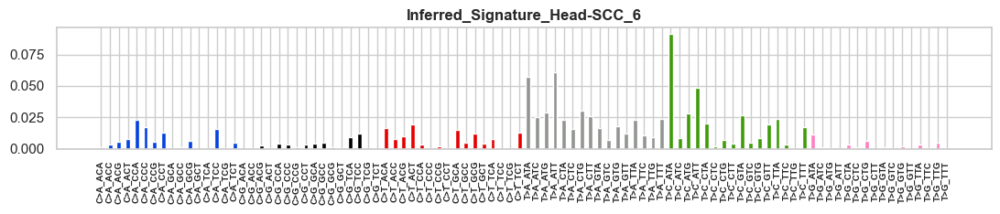

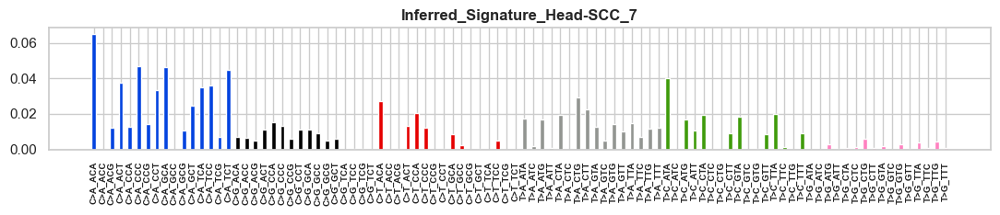

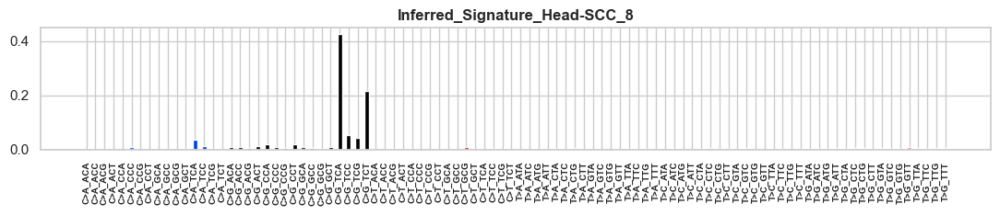

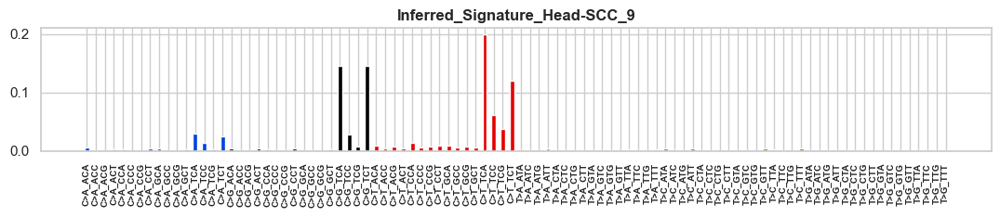

Processing Ovary-AdenoCA


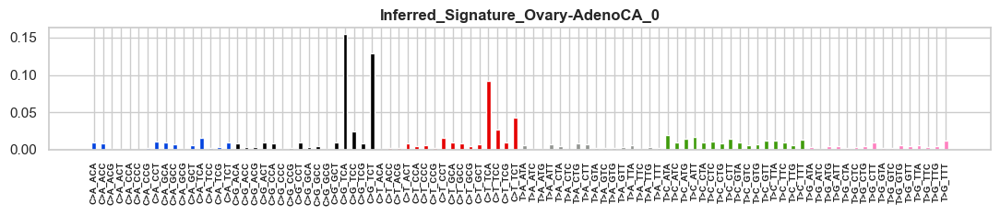

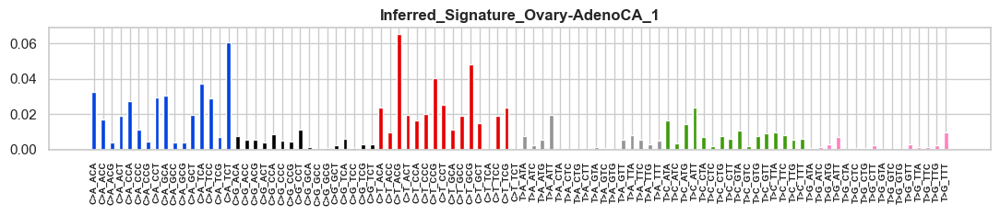

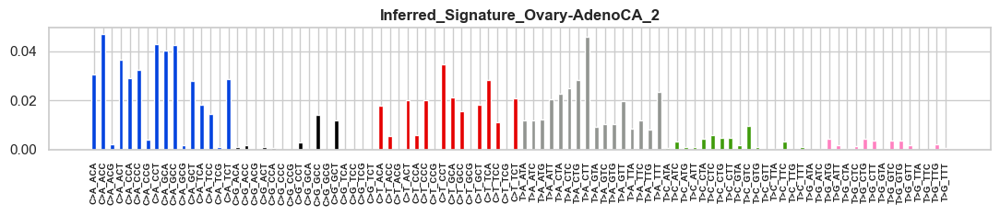

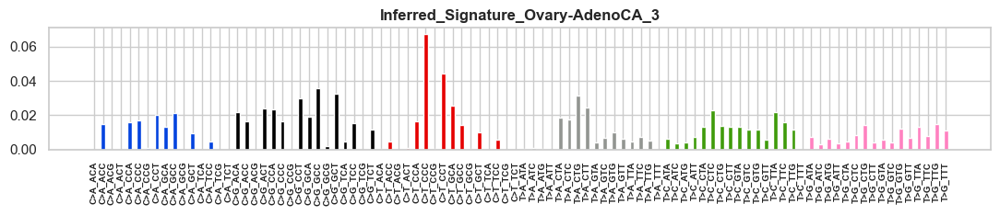

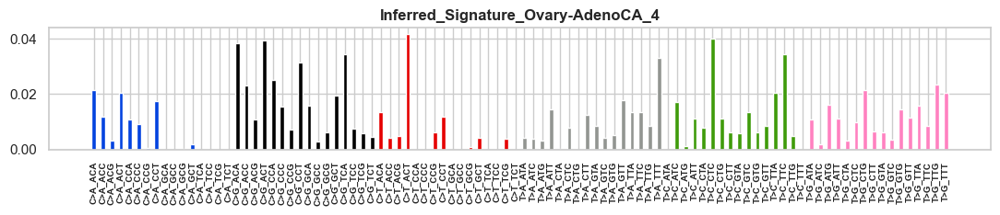

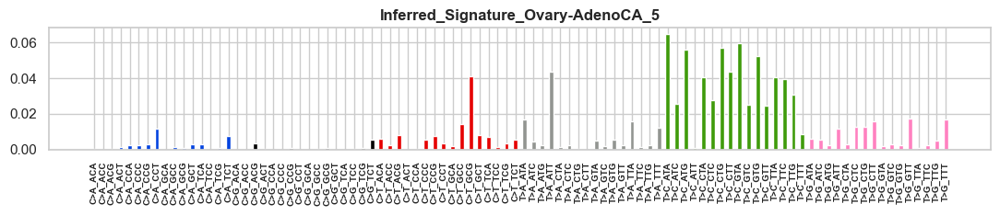

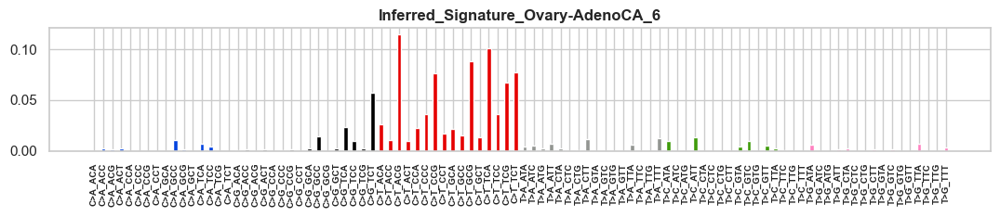

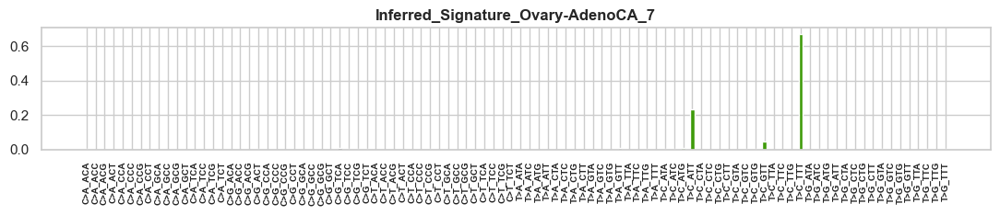

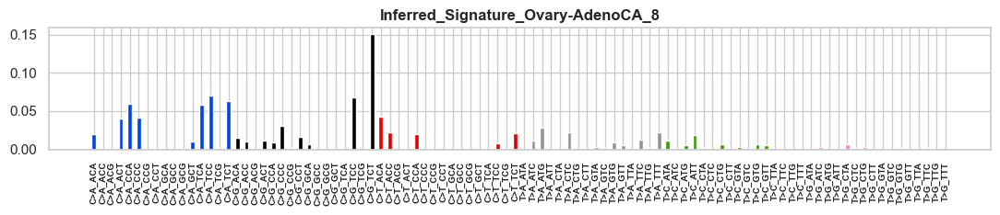

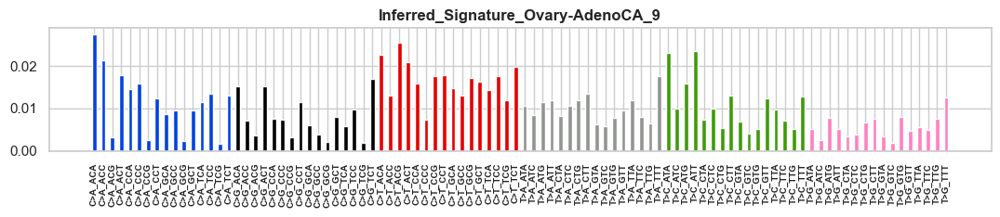

Processing Lung-SCC


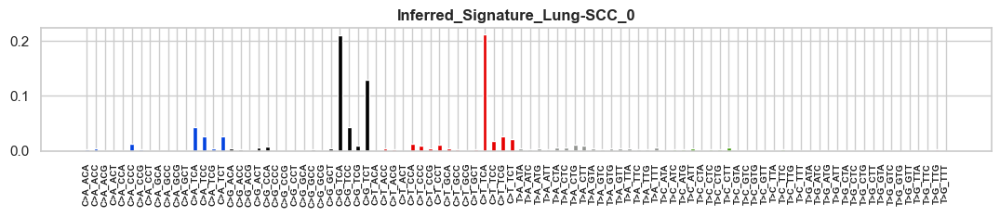

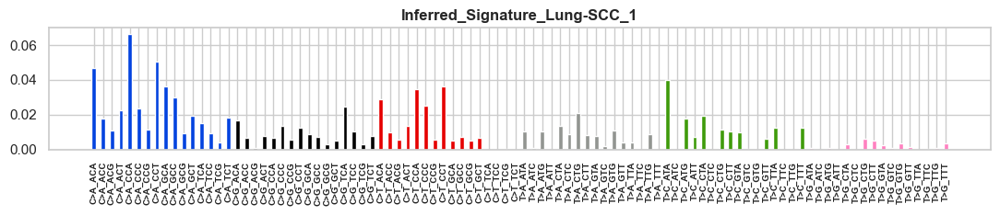

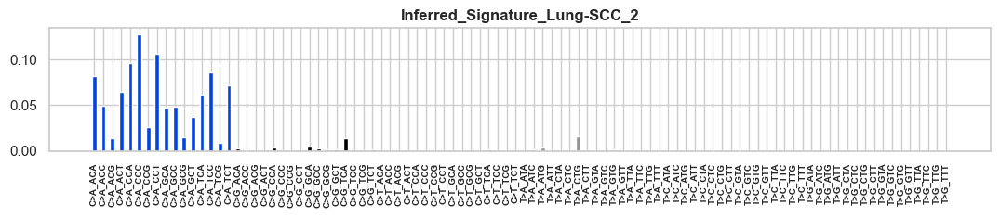

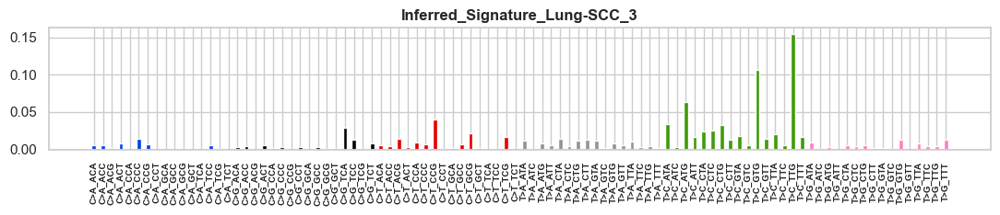

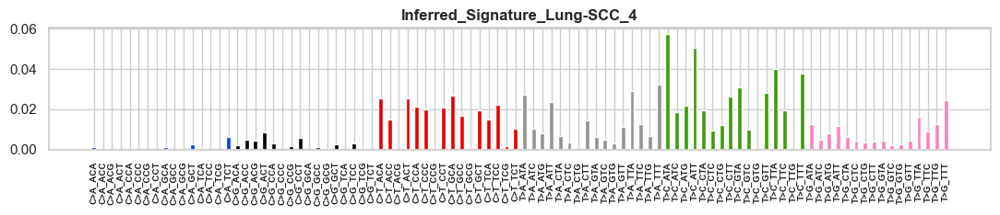

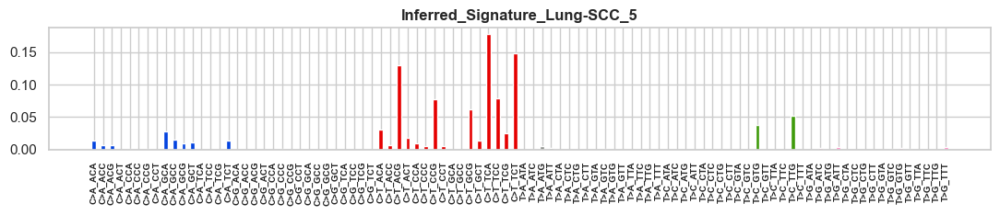

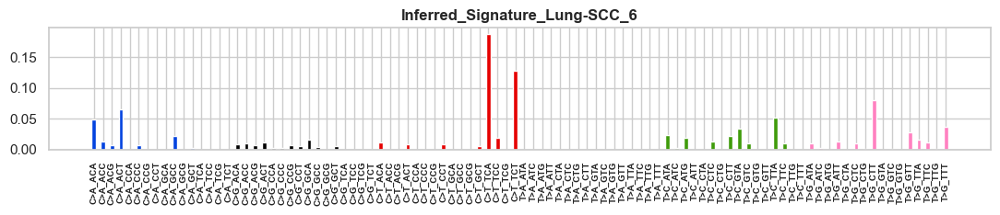

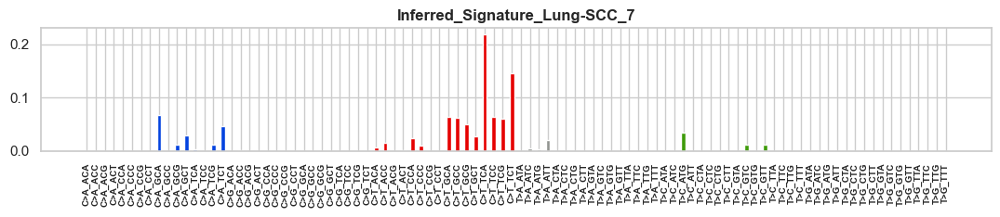

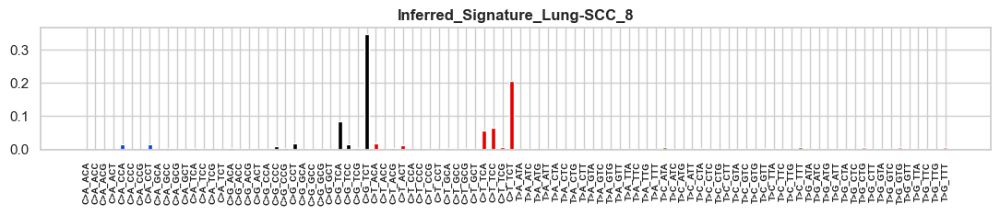

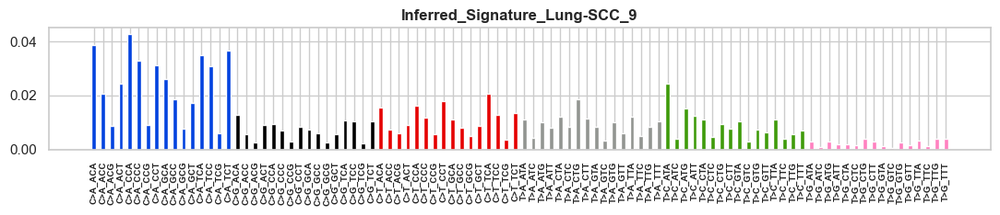

Processing ColoRect-AdenoCA


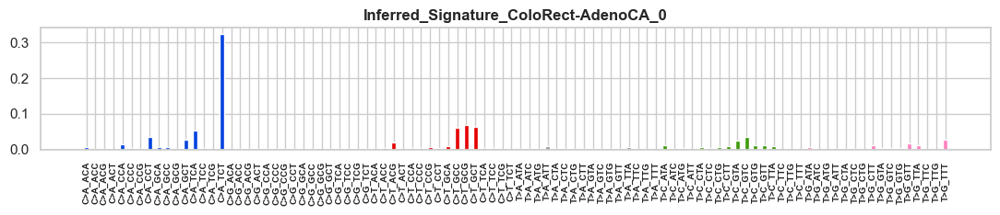

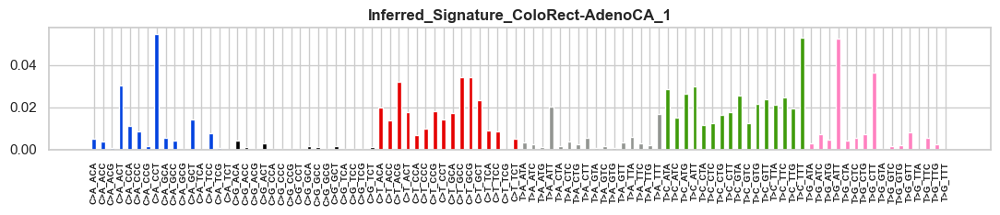

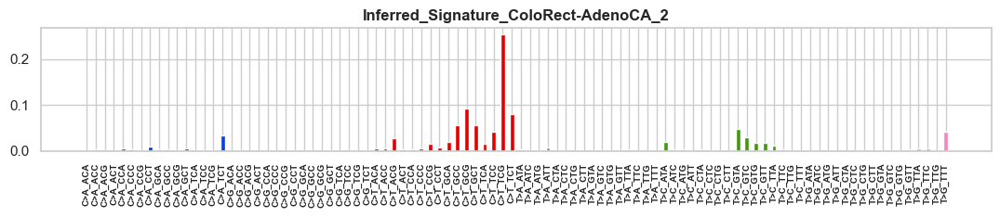

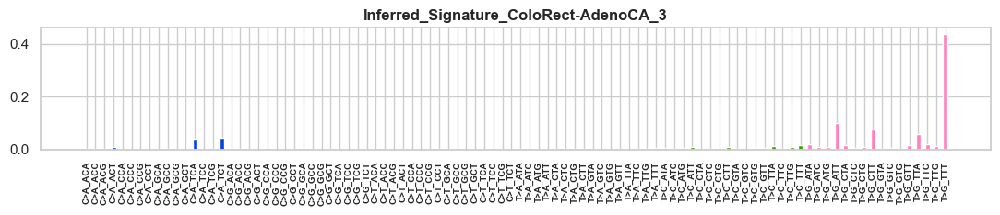

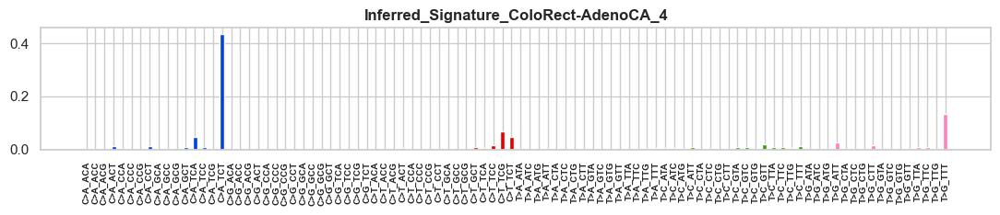

Processing Lymph-BNHL


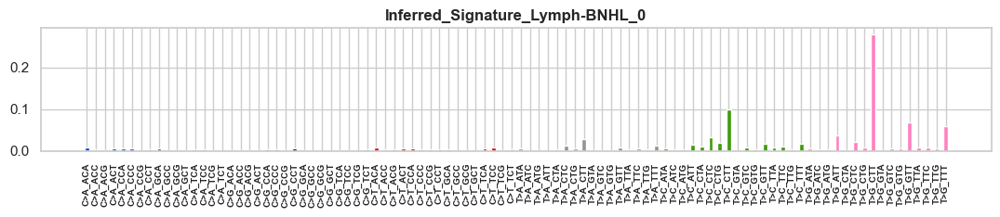

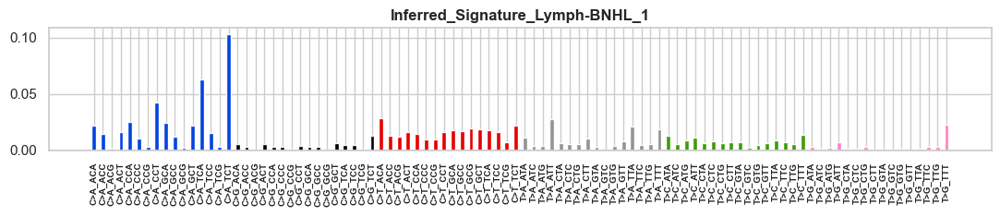

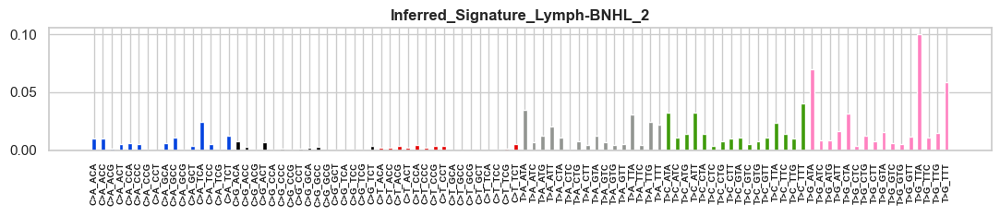

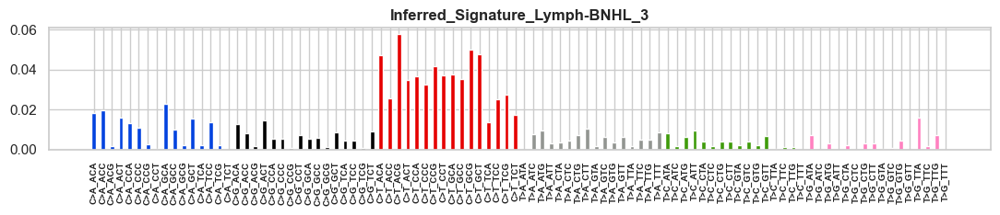

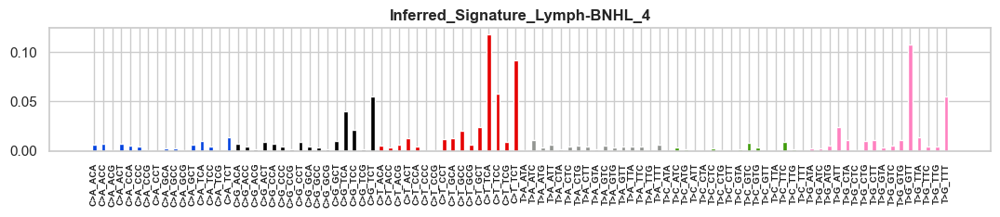

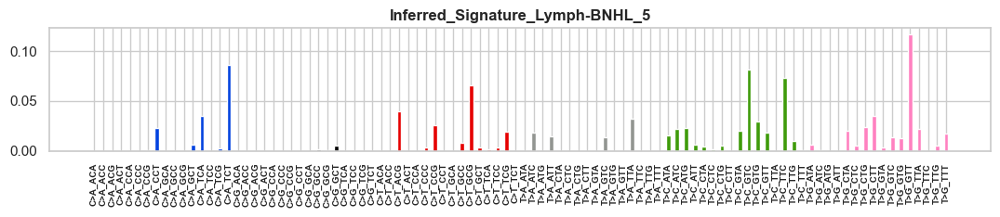

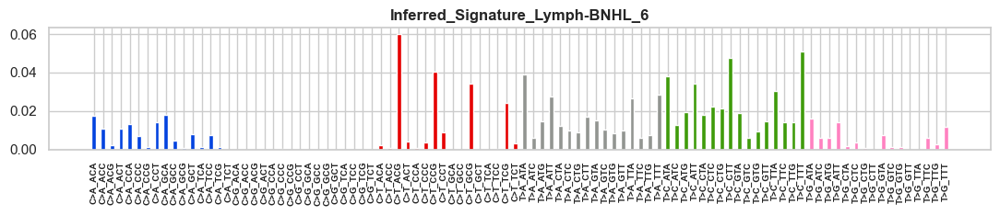

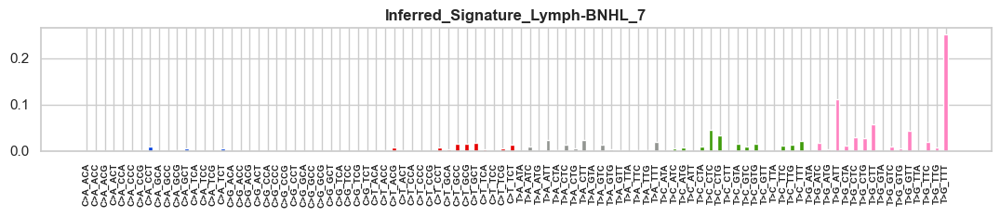

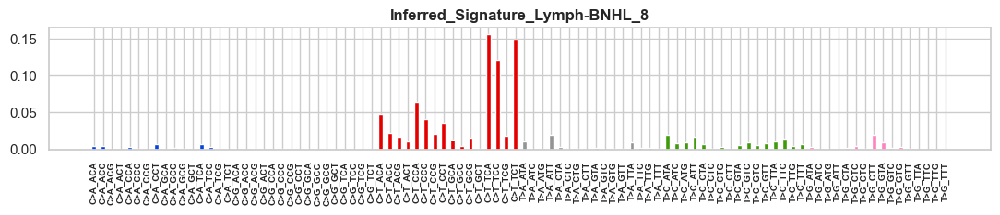

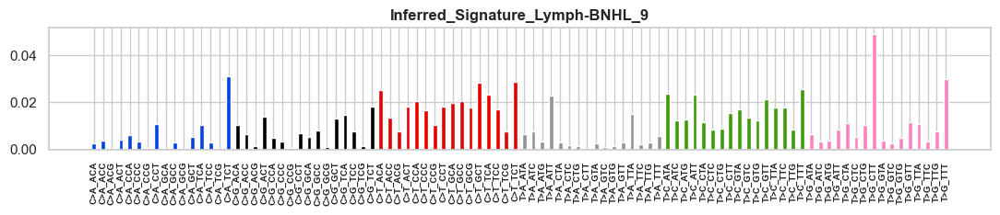

Processing CNS-GBM


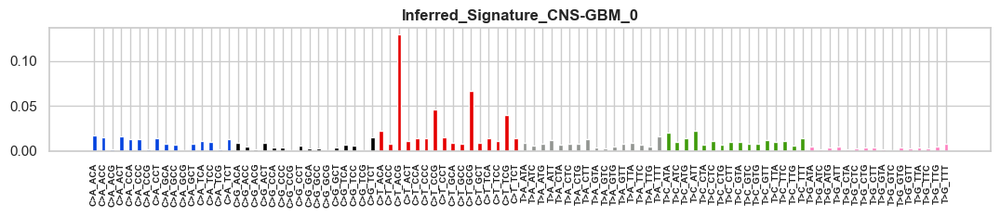

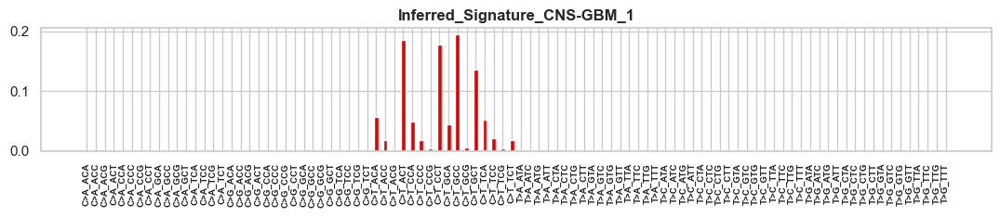

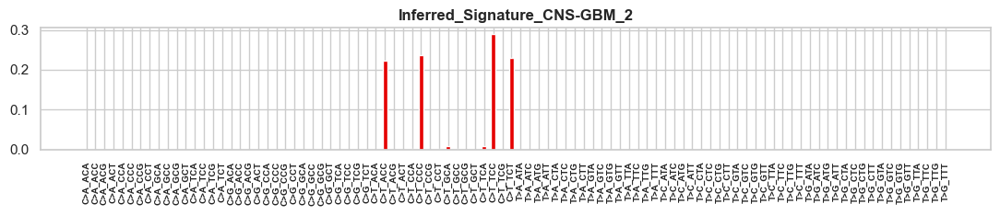

Processing Breast-LobularCA


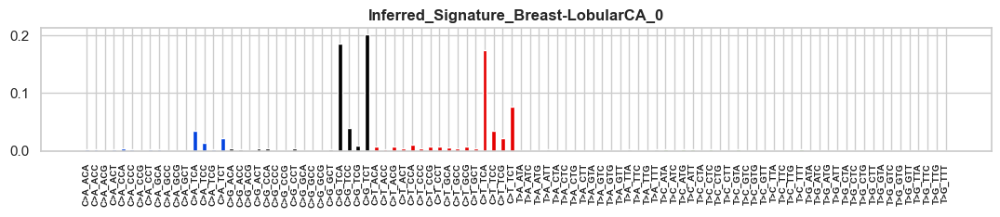

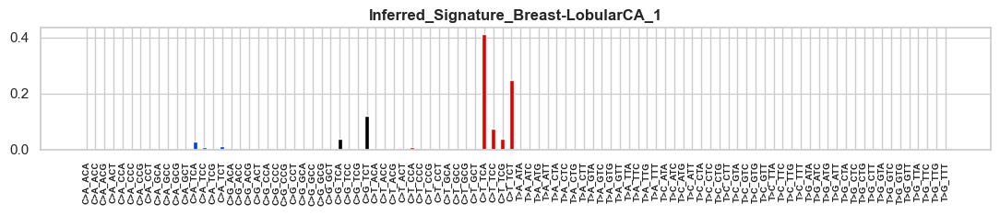

In [38]:
# get the cancer types and the signature names
cancer_types=set([re.search(r'(\S+)\:\:\w+', sample_id).groups()[0] for sample_id in list(somaticMutations.columns[2:])])
signature_names = SBS_sig.columns[2:].tolist() 

# create a dictionary to store the inferred signatures
signature_comparison_results = {}
best_k_for_cancer_type = {}

# lets save also the 
inferred_signatures = {}
for cancer_type in cancer_types:
    print("Processing", cancer_type)
    inferred_signatures[cancer_type] = {}
    
    # here first we extract the input mutation count matrix for each cancer type
    target_index = [re.search(r'(\S+)\:\:\w+', sample_id).groups()[0] == cancer_type  for sample_id in list(somaticMutations.columns[2:])]
    target_mutations = somaticMutations.iloc[:,2:].loc[:, target_index]

    # define the input data
    input_data = target_mutations.values
    # learn the best number of components for each cancer type
    best_k = find_best_k(input_data)
    best_k_for_cancer_type[cancer_type] = best_k
    # fit the NMF model with the best number of components
    model = NMF(n_components=best_k)
    # get the W and H matrices which are the inferred signatures and the activities
    W = model.fit_transform(input_data)
    H = model.components_

    # add to the inferred signatures the normalized inferred signatures

    #normalize the inferred signatures and plot them fror each cancer type and each k
    for i in range(best_k):
        # s is the vector of the normalized inferred signatures for each individual mutation channel 
        s = pd.Series(W.T[i] / sum(W.T[i]), index=list(target_mutations.index.values))
        inferred_signatures[cancer_type][i] = s # i is the index of the inferred signature
        name = f"Inferred_Signature_{cancer_type}_{i}"
        plot_mutationchannels(s, name)
    
    sim = cosine_similarity(W.T, SBS_sig.iloc[:, 2:].values.T) # the sim is the cosine similarity between the inferred signatures and the known signatures
    # Consider matches with cosine similarity above 0.9
    #sim[sim < 0.9] = 0 # if the cosine similarity is below 0.9, we set it to 0
    signature_comparison_results[cancer_type] = sim

Plot the comparison of the learned signatures to the known signatures for each cancer type

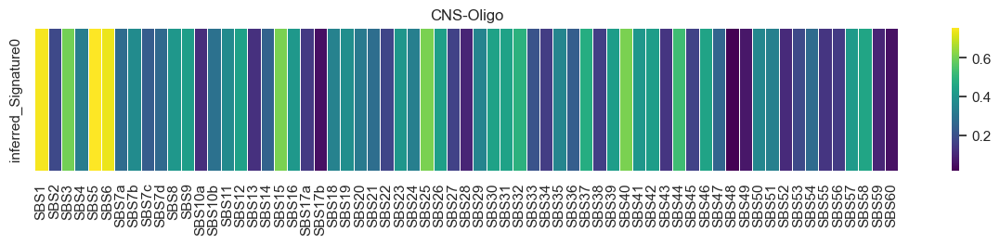

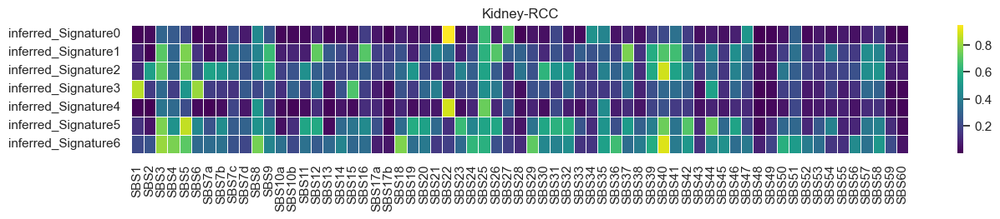

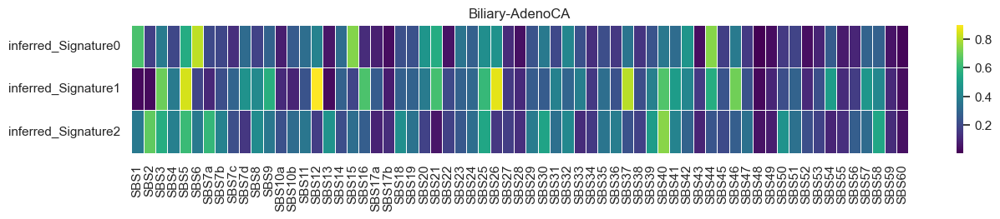

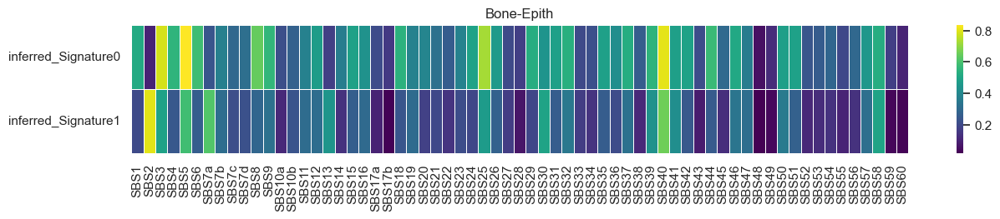

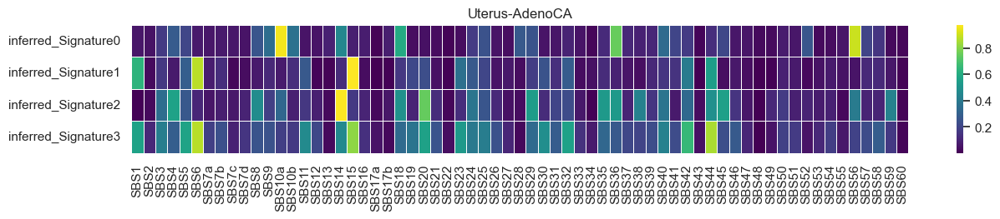

...

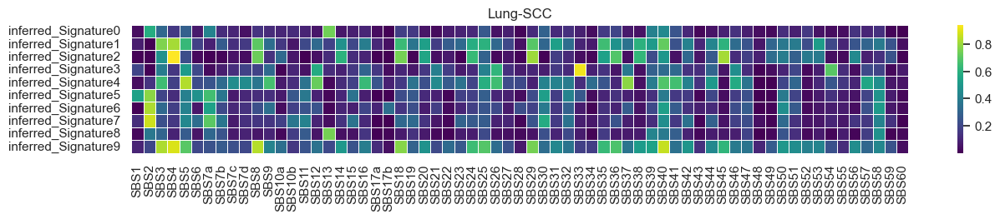

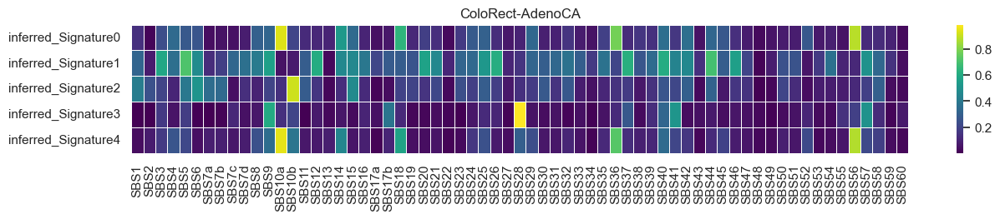

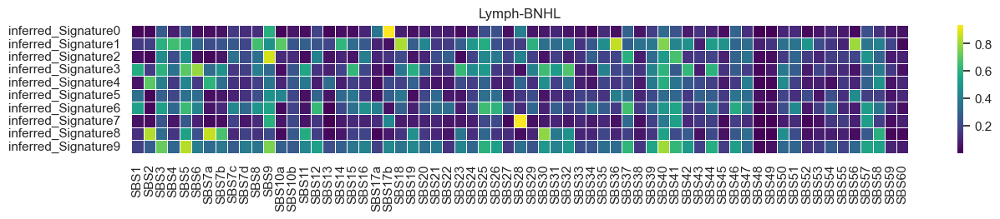

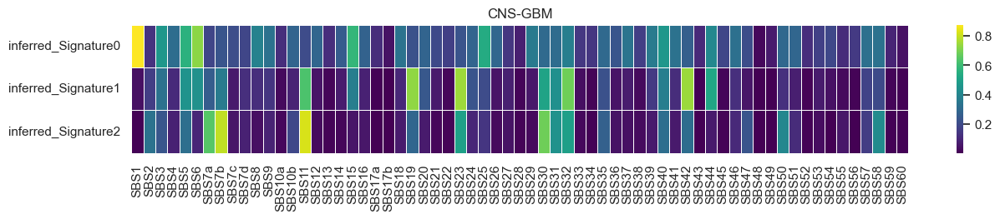

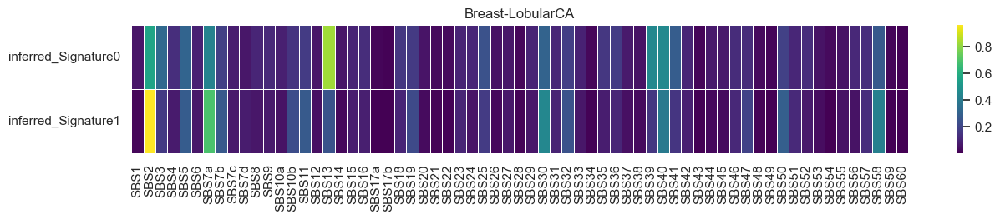

In [39]:
# plot the heatplot for each cancer type to compare the inferred signatures with the known signatures

for cancer_type, sim in signature_comparison_results.items():
    sns.set(rc={"figure.figsize":(15,2)})
    sns.heatmap(sim, linewidth = 0.5, cmap = 'viridis', xticklabels = SBS_sig.columns[2:].values, 
                 yticklabels =  ["inferred_Signature" + str(i) for i in range(sim.shape[0])])
    plt.title(cancer_type)
    plt.show()
    

Plot only the signatures that have a cosine similarity > 0.9



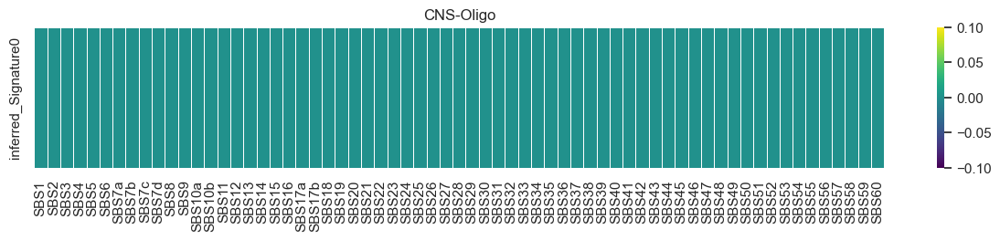

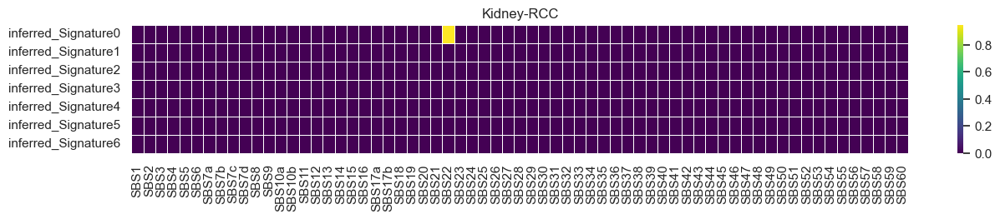

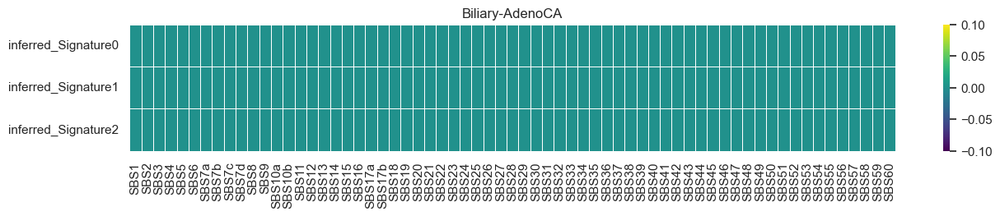

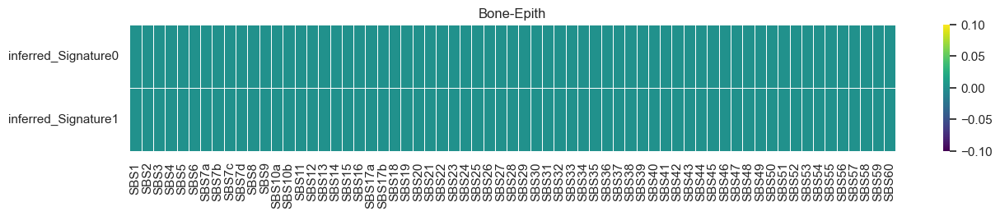

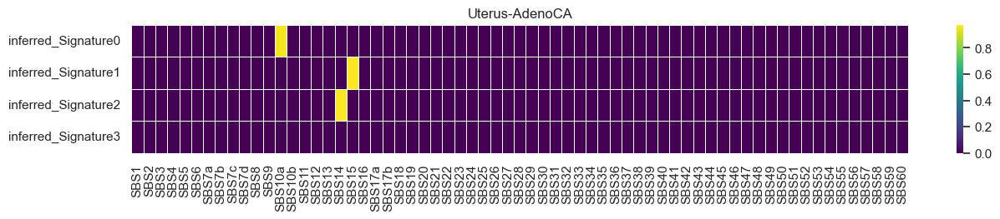

...

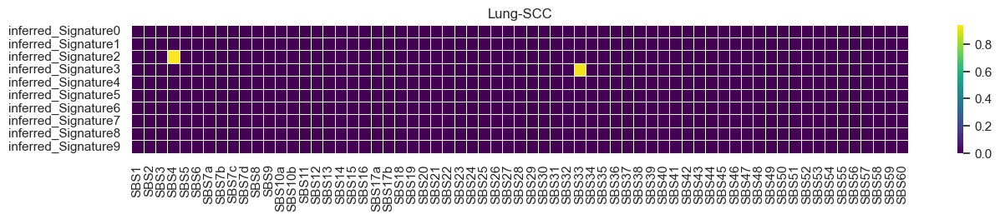

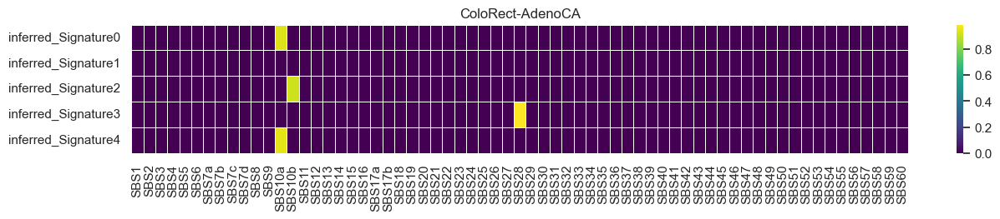

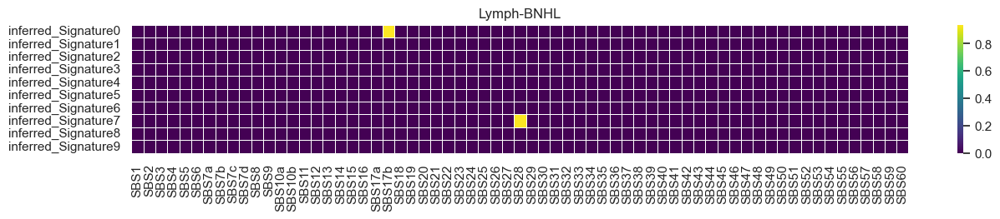

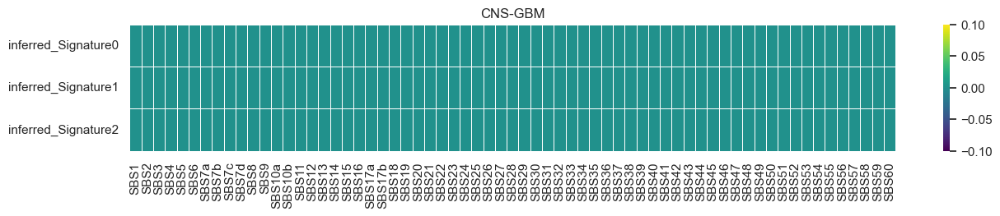

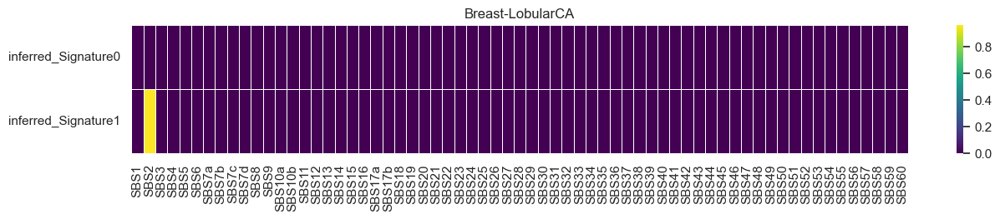

In [41]:
for cancer_type, sim in signature_comparison_results.items():
    # filter out the cosine similarity values below 0.9
    sim2 = sim.copy()
    sim2[sim2 < 0.9] = 0
    sns.set(rc={"figure.figsize":(15,2)})
    sns.heatmap(sim2, linewidth = 0.5, cmap = 'viridis', xticklabels = SBS_sig.columns[2:].values, 
                 yticklabels =  ["inferred_Signature" + str(i) for i in range(sim2.shape[0])])
    plt.title(cancer_type)
    plt.show()
    

    
    

In [50]:
# get from signature_comparison_results['Bone-Benign'] the largest cosine similarity value

np.max(signature_comparison_results['Bone-Benign'])


0.8242868407988582

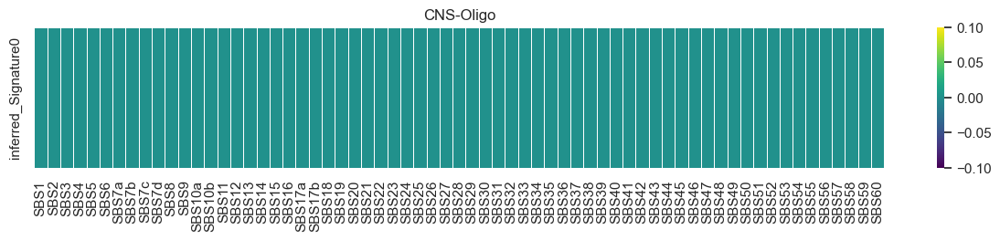

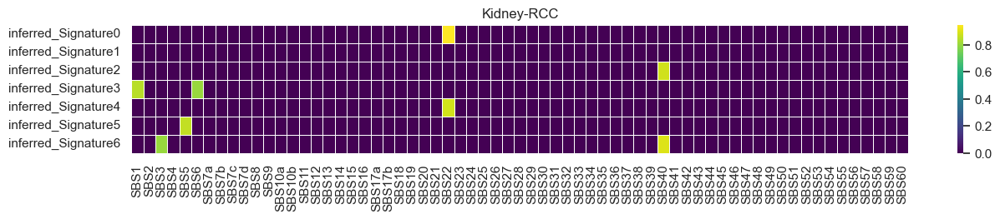

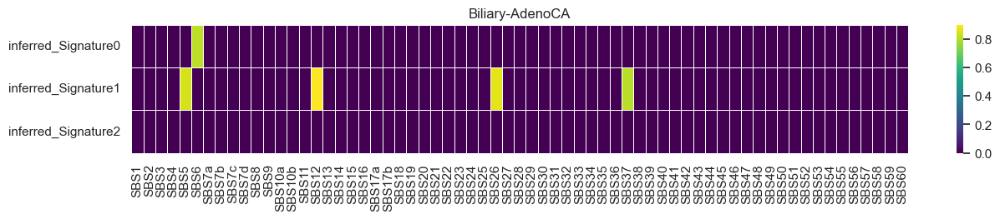

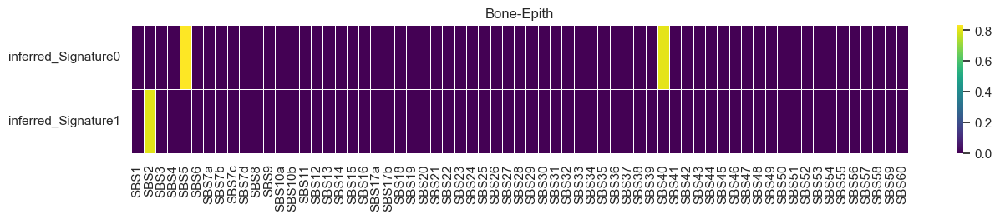

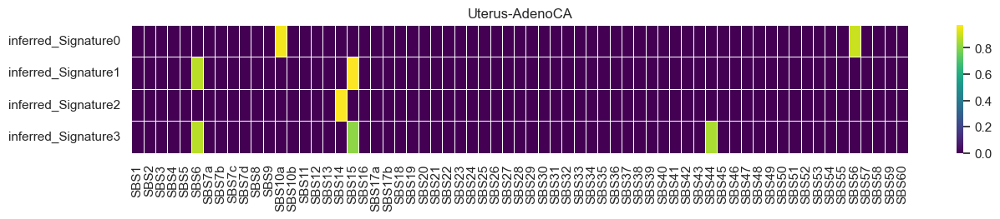

...

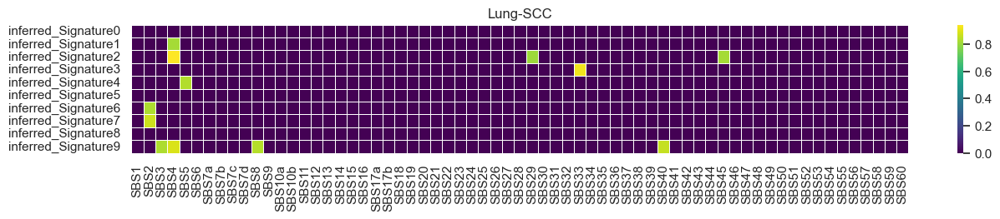

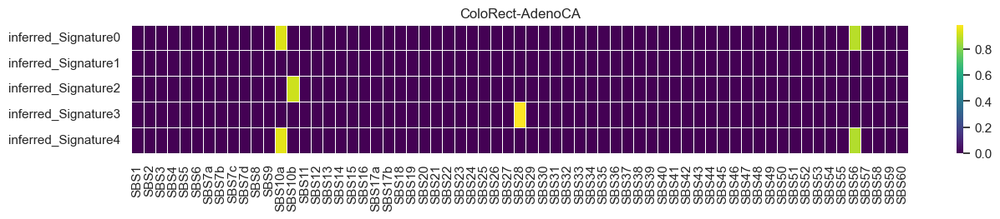

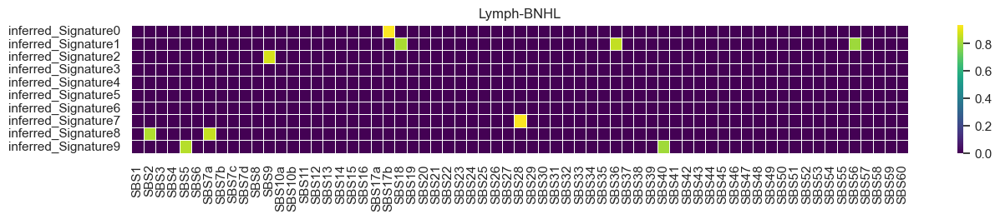

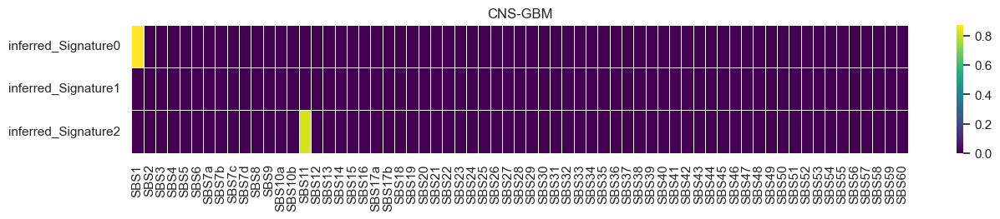

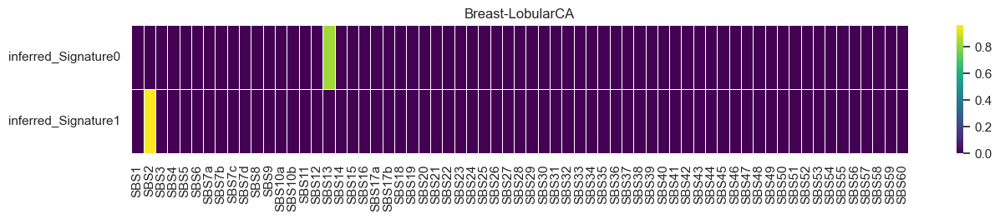

In [47]:
for cancer_type, sim in signature_comparison_results.items():
    # filter out the cosine similarity values below 0.9
    sim3 = sim.copy()
    sim3[sim3 < 0.8] = 0
    sns.set(rc={"figure.figsize":(15,2)})
    sns.heatmap(sim3, linewidth = 0.5, cmap = 'viridis', xticklabels = SBS_sig.columns[2:].values, 
                 yticklabels =  ["inferred_Signature" + str(i) for i in range(sim3.shape[0])])
    plt.title(cancer_type)
    plt.show()

#### Problem 2b:
Perform hierarchical clustering of the signatures that you found from different cancer types. Then form a mean signature for each cluster (use 0.9 or higher cosine similarity as a cut off). Compare these mean signatures to the known signatures given.

In [ ]:
# using the found signatures to perform hierarchical clustering using 0.9 or higher cosine similarity as a cutt off 

from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.spatial.distance import pdist
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import normalize

# get the cancer types and the signature names


In [104]:
# import the packages needed for clustering
from scipy.cluster.hierarchy import dendrogram
from scipy.spatial.distance import squareform 

# mapping the signatures to the known signatures
signature_to_sbs = {}  
signature_names = SBS_sig.columns[2:].tolist() 

# Step 1: Map each inferred signature to its closest known SBS signature
for cancer_type, sim_matrix in signature_comparison_results.items():
    for i, sim_vector in enumerate(sim_matrix):
        max_sim_index = np.argmax(sim_vector)  # Index of the closest known signature
        sbs_name = signature_names[max_sim_index]  # Name of the SBS signature
        label = f"{cancer_type}_Signature_{i}_{sbs_name}"
        signature_to_sbs[label] = sim_vector

from scipy.cluster.hierarchy import linkage, fcluster

signatures_matrix = []  # To hold all signature vectors
labels = []  
# Collect signatures and their labels
for cancer_type, signatures in inferred_signatures.items():
    for i, signature in signatures.items():
        signatures_matrix.append(signature.values)
        label = f"{cancer_type}_Signature_{i}"
        labels.append(label)

# Convert to an array for distance calculation
signatures_matrix = np.array(signatures_matrix)

# Convert cosine similarity to distance and ensure the diagonal is zero
distances = 1 - cosine_similarity(signatures_matrix)
np.fill_diagonal(distances, 0)

# Generate updated labels that include the SBS names
updated_labels = [f"{label} ({signature_to_sbs[label]})" for label in labels]

# Perform hierarchical clustering using the 'average' linkage method
Z = linkage(squareform(distances), 'average')

# Plot the dendrogram
plt.figure(figsize=(15, 40))
dendrogram(Z, labels=updated_labels, orientation='right', leaf_font_size=12) 

plt.title("Hierarchical Clustering Dendrogram with SBS Names")
plt.show()




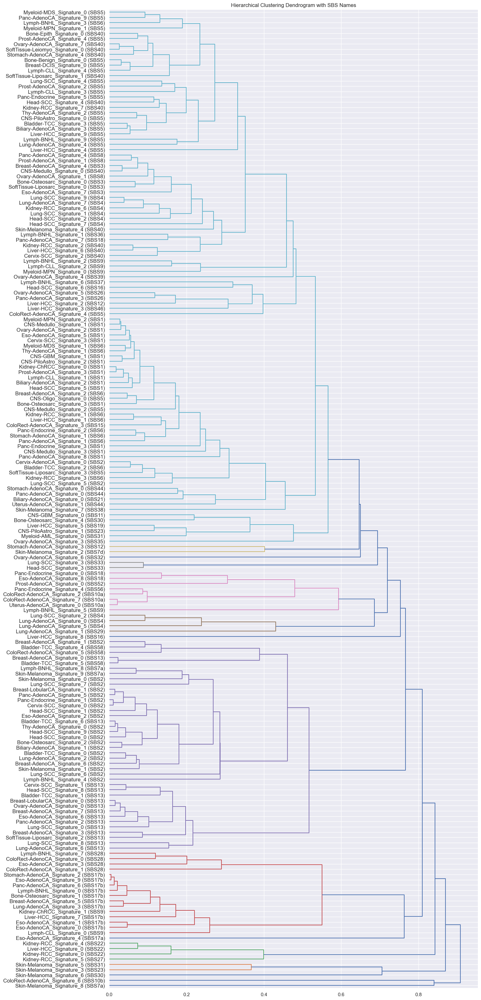

In [89]:

from scipy.cluster.hierarchy import linkage, fcluster

signatures_matrix = []  # To hold all signature vectors
labels = []  
# Collect signatures and their labels
for cancer_type, signatures in inferred_signatures.items():
    for i, signature in signatures.items():
        signatures_matrix.append(signature.values)
        label = f"{cancer_type}_Signature_{i}"
        labels.append(label)

# Convert to an array for distance calculation
signatures_matrix = np.array(signatures_matrix)

# Convert cosine similarity to distance and ensure the diagonal is zero
distances = 1 - cosine_similarity(signatures_matrix)
np.fill_diagonal(distances, 0)

# Generate updated labels that include the SBS names
updated_labels = [f"{label} ({signature_to_sbs[label]})" for label in labels]

# Perform hierarchical clustering using the 'average' linkage method
Z = linkage(squareform(distances), 'average')

# Plot the dendrogram
plt.figure(figsize=(15, 40))
dendrogram(Z, labels=updated_labels, orientation='right', leaf_font_size=12) 

plt.title("Hierarchical Clustering Dendrogram with SBS Names")
plt.show()

I am out of brain here, do not know where to actually compare the signatures ? to the SBS_sig data frame ? And how to actually form the mean signature for each cluster ? I am not sure if I understand the question correctly.

#### Problem 2c:
**Try to do the inference across all cancer types at once. How many good matches you find when you compare to the 65 given signatures (cosine similarity > 0.9). Comment why this way of doing the inference is difficult (or is it?).**

Here also ? What what is meant by inference across all cancer types at once ? I am not sure if I understand the question correctly.
I think I just did this? <br> Or is it so that I need to to fir the NFM to the whole data set instead of the individual cancer types ? 

In [119]:
# first let's find the best number of components for the whole dataset
k = find_best_k(somaticMutations.iloc[:,2:].values)
print(f"The best number of components for the whole dataset is: {k}")


The best number of components for the whole dataset is: 10


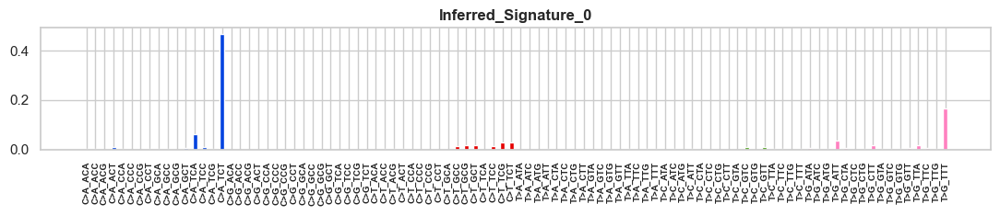

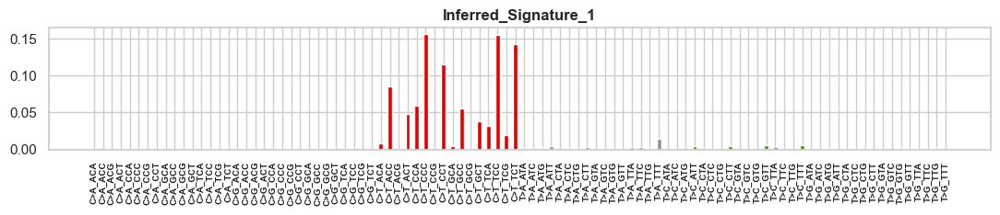

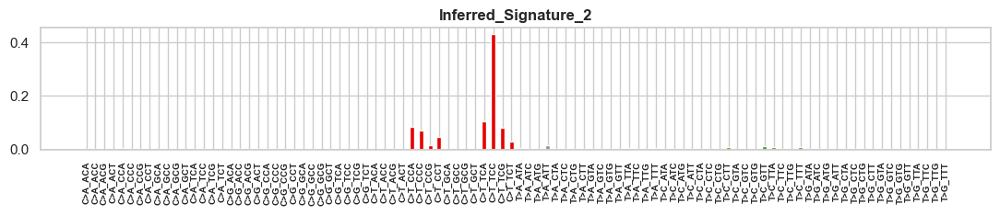

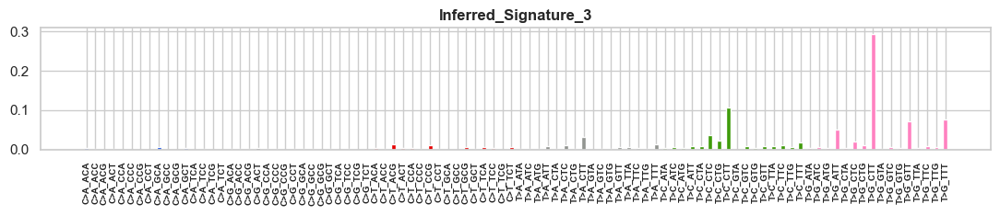

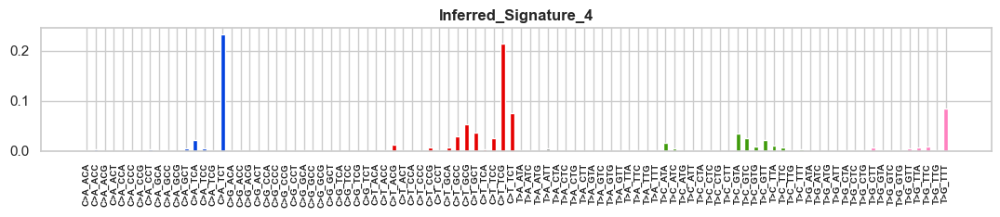

...

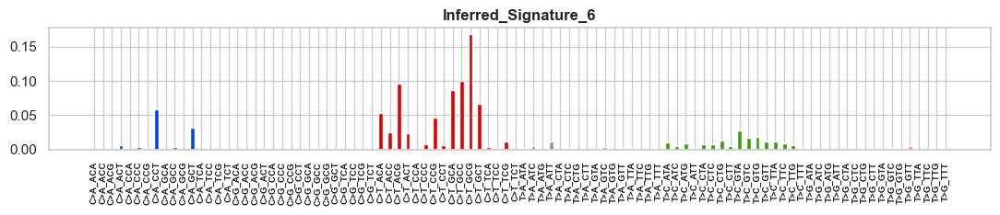

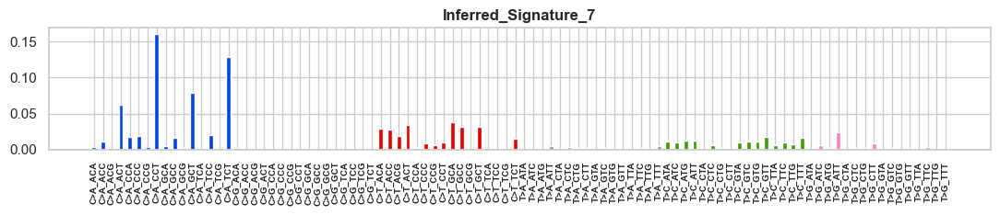

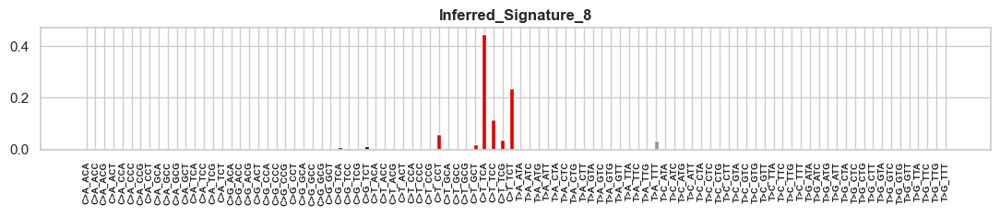

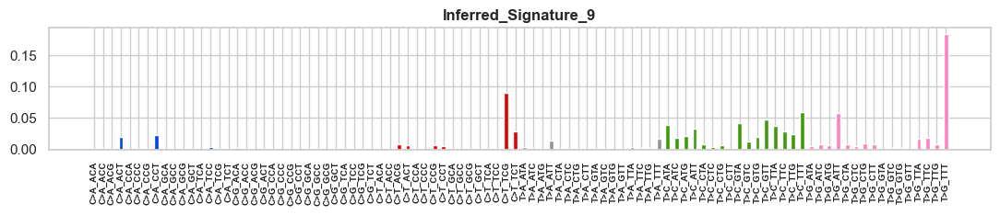

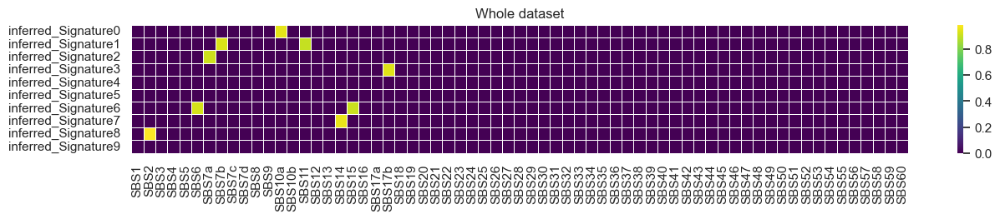

In [120]:
# fit the NMF model with the best number of components
model = NMF(n_components=k)
W = model.fit_transform(somaticMutations.iloc[:,2:].values)
H = model.components_

#normalize the inferred signatures and plot them fror each cancer type and each k
for i in range(k):
    s = pd.Series(W.T[i] / sum(W.T[i]), index=list(somaticMutations.index.values))
    name = f"Inferred_Signature_{i}"
    plot_mutationchannels(s, name)

sim = cosine_similarity(W.T, SBS_sig.iloc[:, 2:].values.T)

# Consider matches with cosine similarity above 0.9
sim[sim < 0.9] = 0

sns.set(rc={"figure.figsize":(15,2)})
sns.heatmap(sim, linewidth = 0.5, cmap = 'viridis', xticklabels = SBS_sig.columns[2:].values, 
                 yticklabels =  ["inferred_Signature" + str(i) for i in range(sim.shape[0])])
plt.title("Whole dataset")
plt.show()

